In [2]:
import scanpy
import anndata
import matplotlib
from matplotlib import pyplot
import hdf5plugin
import numpy
import scvelo
import seaborn
import pandas
import warnings
import cellrank
import pygam
import gseapy

In [3]:
# Read input file

working_directory = "RNA Sequencing Data/"

# Use adata from velocity analysis
# adata = scanpy.read_h5ad(working_directory + "/velocity_sdevelo.h5ad")

# Or read saved anndata objects from Cellrank analysis
base_name = "cellrank_1.4"
adata = scanpy.read_h5ad(
    working_directory+f"/{base_name} cells.h5ad"
)
dead_end_adata = scanpy.read_h5ad(
    working_directory+f"/{base_name} dead end genes.h5ad"
)
mESC_adata = scanpy.read_h5ad(
    working_directory+f"/{base_name} mESC genes.h5ad"
)
driver_df = pandas.read_csv(
    working_directory+f"{base_name} driver genes.csv",
    index_col=0
)

print(adata)

AnnData object with n_obs × n_vars = 12791 × 2000
    obs: 'barcode', 'batch', 'sample', 'group', 'day', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'latent_time', 'sde_velocity_self_transition', 'manual_root', 'manual_end', 'sde_velocity_pseudotime', 'macrostates_fwd', 'term_states_fwd', 'term_states_fwd_probs', 'init_states_fwd', 'init_states_fwd_probs', 'clusters_gradients', 'fate_probabilities_Day 12 Control', 'fate_probabilities_mESC'
    var: 'ensemble_ids', 'gene_symbol', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_sigma_1', 'fit_sigma_2'
    uns: 'T_fwd_params', 'clusters_gradients_colors', 'coarse_fwd', 'eigendecomposition_fwd', 'init_states_fwd_colors', 'lineage_Day 12 Control_trend', 'lineage_mESC_t

In [11]:
print(adata.uns["sde_velocity_params"])

{'embeddings': array(['fdl'], dtype=object), 'mode_neighbors': 'distances', 'n_recurse_neighbors': 2}


In [14]:
genes= ["Hic2", "Krt14", 'Atf3', 'Barx2', 'Hmgb3', 'Hoxa7', 'Hoxa9', 'Myc', 'Ovol1', 'Tlx2',
       'Tshz1', 'Zbtb7c']
print(adata[:, genes].layers["sde_velocity"].mean(axis=0))
print(adata[:, genes].var["fit_alpha"][:10])
print(adata[:, genes].var["fit_beta"][:10])
print(adata[:, genes].var["fit_t_"][:10])



[ 6.02866444e-04  6.44537678e-01 -3.53249474e-03 -5.75549351e-02
  7.02049539e-01 -9.68898145e-02  2.85822141e-01 -9.17371033e-02
 -7.60792620e-02  5.72931077e-01 -3.55715936e-02  3.62356639e-03]
gene_names
Hic2        5.895187
Krt14    1000.000000
Atf3        3.982388
Barx2    1000.000000
Hmgb3     498.423340
Hoxa7    1000.000000
Hoxa9    1000.000000
Myc        15.999613
Ovol1    1000.000000
Tlx2     1000.000000
Name: fit_alpha, dtype: float32
gene_names
Hic2      49.523148
Krt14     47.726837
Atf3      37.843369
Barx2     49.211880
Hmgb3     67.572182
Hoxa7     45.879704
Hoxa9     44.822433
Myc      140.789413
Ovol1     47.664009
Tlx2      48.859268
Name: fit_beta, dtype: float32
gene_names
Hic2     0.860880
Krt14    0.100000
Atf3     0.988519
Barx2    0.100000
Hmgb3    0.100000
Hoxa7    0.100000
Hoxa9    0.100000
Myc      0.714232
Ovol1    0.100000
Tlx2     0.100000
Name: fit_t_, dtype: float64


In [7]:
# Suppress warnings

warnings.simplefilter("ignore", category=UserWarning)

In [8]:
# Create velocity kernel

velocity_kernel = cellrank.kernels.VelocityKernel(adata, vkey="sde_velocity")
velocity_kernel.compute_transition_matrix()

  0%|          | 0/12791 [00:00<?, ?cell/s]

  0%|          | 0/12791 [00:00<?, ?cell/s]

VelocityKernel[n=12791, model='deterministic', similarity='correlation', softmax_scale=6.344]

In [9]:
# Create kernel based on latent time

latent_time_kernel = cellrank.kernels.PseudotimeKernel(adata, time_key = "latent_time")
latent_time_kernel.compute_transition_matrix()

  0%|          | 0/12791 [00:00<?, ?cell/s]

PseudotimeKernel[n=12791, dnorm=False, scheme='hard', frac_to_keep=0.3]

In [10]:
# Kernel based on gene expression similarity

# Neigborhood calculation is based on 30 pcs, 30 neighbors
print(adata.uns["neighbors"])

connectivity_kernel = cellrank.kernels.ConnectivityKernel(adata)
connectivity_kernel.compute_transition_matrix()

{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidean', 'n_neighbors': 30, 'n_pcs': 30, 'random_state': 0}}


ConnectivityKernel[n=12791, dnorm=True, key='connectivities']

In [11]:
# Combine all three kernels

combined_kernel = 0.4*velocity_kernel + 0.4*latent_time_kernel + 0.2*connectivity_kernel
combined_kernel.compute_transition_matrix()

(0.4 * VelocityKernel[n=12791, model='deterministic', similarity='correlation', softmax_scale=6.344] + 0.4 * PseudotimeKernel[n=12791, dnorm=False, scheme='hard', frac_to_keep=0.3] + 0.2 * ConnectivityKernel[n=12791, dnorm=True, key='connectivities'])

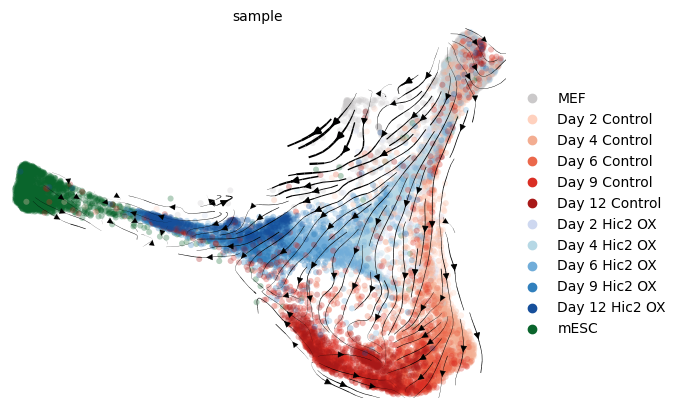

In [12]:
# Plot kernel vector field

combined_kernel.plot_projection(basis="fdl", color="sample", legend_loc="right margin")

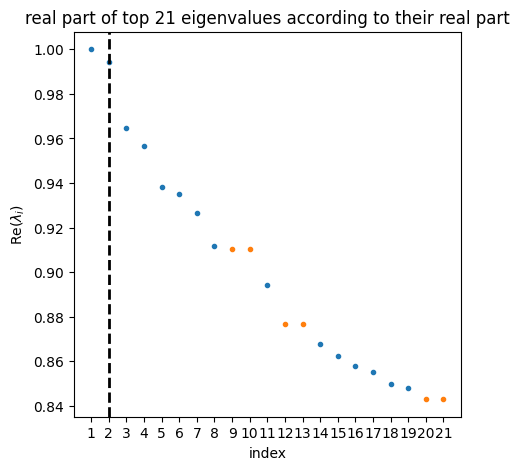

In [13]:
estimator = cellrank.estimators.GPCCA(combined_kernel)
estimator.compute_schur()
estimator.plot_spectrum(real_only=True)

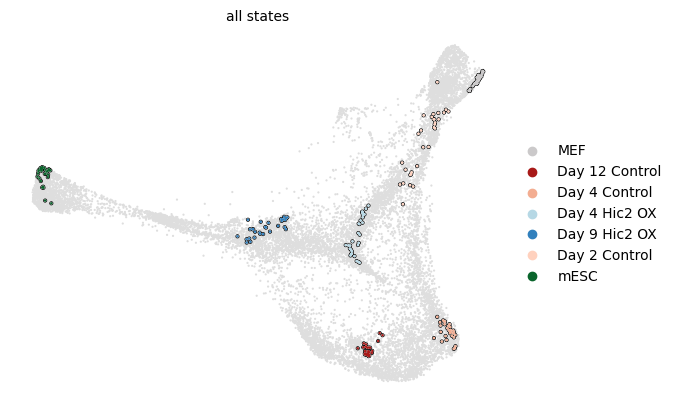

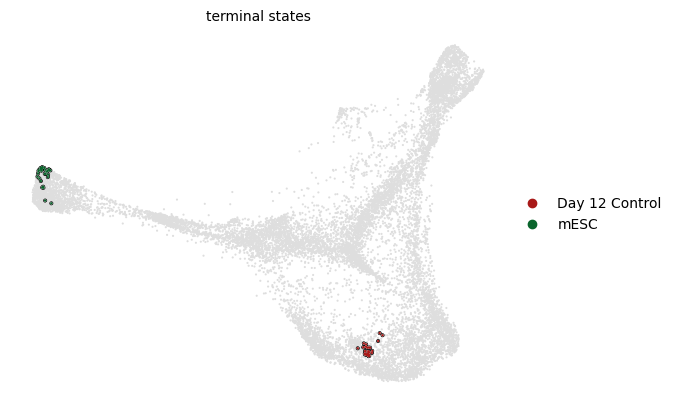

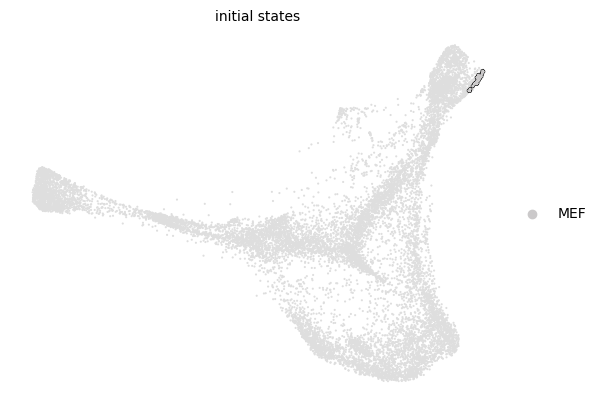

In [14]:
# Find 7 macrostates
estimator.compute_macrostates(n_states=7, cluster_key="sample")

estimator.plot_macrostates(which="all", legend_loc="right", s=10, basis="fdl")
macrostates = estimator.macrostates_memberships.names

# Predict terminal states

estimator.predict_terminal_states(method="eigengap")
estimator.plot_macrostates(which="terminal", legend_loc="right", discrete=True, basis="fdl")
terminal_states = estimator.terminal_states_memberships.names

# Predict initial states

estimator.predict_initial_states()
estimator.plot_macrostates(which="initial", legend_loc="right", basis="fdl", discrete=True)
initial_states = estimator.initial_states_memberships.names

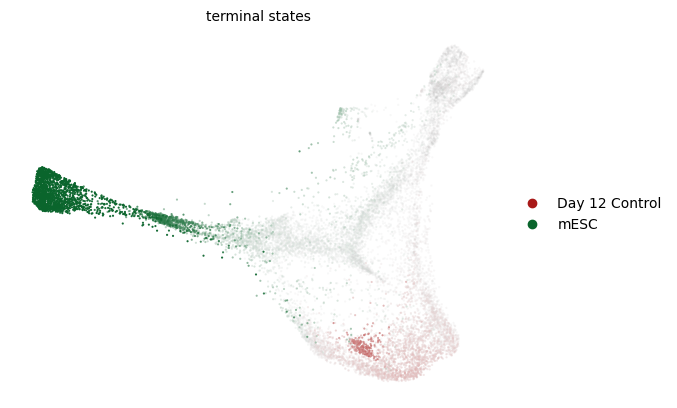

In [15]:
# Plot probability of cells belonging to the terminal states

estimator.plot_macrostates(which="terminal", legend_loc="right", discrete=False, basis="fdl")

In [16]:
# Plot stability values. These are used to find terminal states with method="stability" and show that Day 4 control and Day 9 Hic2 OX are metastable

stability_values = estimator.coarse_T.values.diagonal()

stability_df = pandas.DataFrame({
    "Macrostate": macrostates,
    "Stability": stability_values
}).sort_values("Stability", ascending=False)

print(stability_df)

       Macrostate  Stability
6            mESC   0.996307
1  Day 12 Control   0.976904
2   Day 4 Control   0.972855
4   Day 9 Hic2 OX   0.964469
3   Day 4 Hic2 OX   0.940375
0             MEF   0.936240
5   Day 2 Control   0.928947


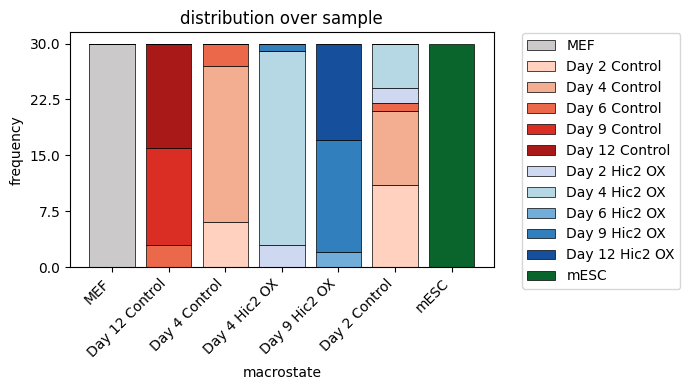

In [17]:
estimator.plot_macrostate_composition(key="sample", figsize=(7, 4))

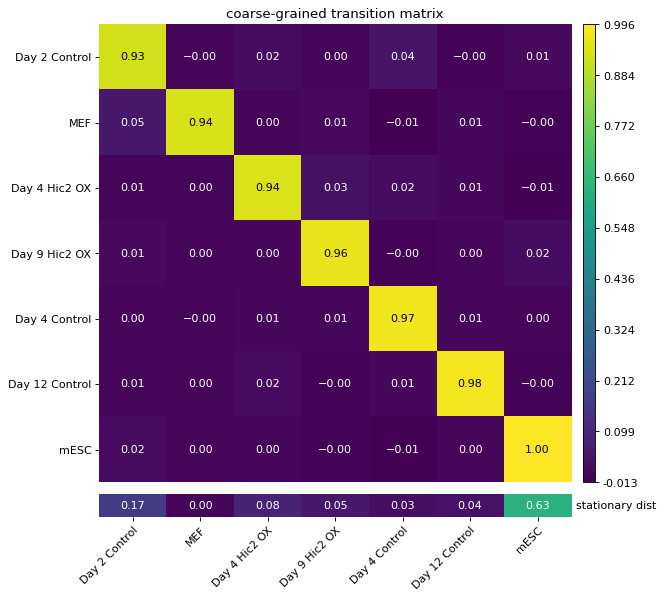

In [18]:
estimator.plot_coarse_T()

  0%|          | 0/2 [00:00<?, ?/s]

  0%|          | 0/2 [00:00<?, ?/s]

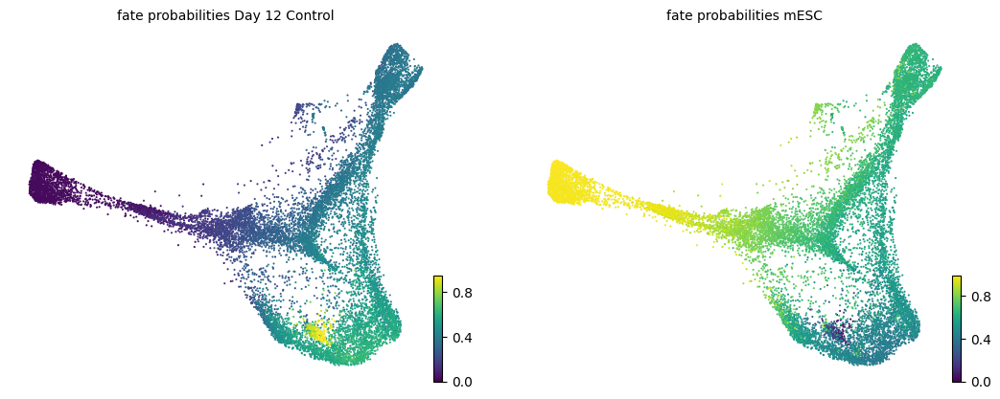

In [19]:
# Estimate fate probabilities

estimator.compute_fate_probabilities()

# Add fate probabilities to adata
for terminal_state in terminal_states:
    adata.obs[f"fate_probabilities_{terminal_state}"] = estimator.fate_probabilities[terminal_state].X.flatten()
estimator.compute_fate_probabilities()
estimator.plot_fate_probabilities(same_plot=False, basis="fdl")

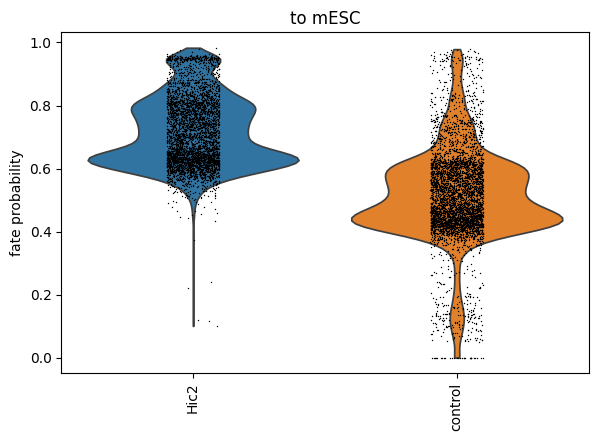

In [20]:
# Aggregate fate probabilities

cellrank.pl.aggregate_fate_probabilities(
    adata,
    mode="violin",
    lineages=["mESC"],
    cluster_key="group",
    clusters=["control", "Hic2"],
)

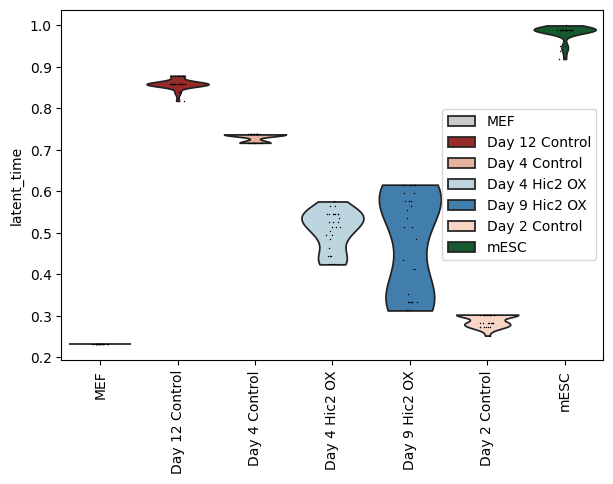

In [21]:
# Show macrostates in latent time

scanpy.pl.violin(adata, keys=["latent_time"], groupby="macrostates_fwd", rotation=90)

## Find driver genes for the terminal states

In [22]:
# Find driver genes for all terminal states

reprogramming_groups = ["Hic2", "control"]

driver_df = estimator.compute_lineage_drivers(
    cluster_key="group", clusters=reprogramming_groups
)
corr_columns = [state+"_corr" for state in terminal_states]
pval_columns = [terminal_states[0]+"_pval"]
qval_columns = [terminal_states[0]+"_qval"]

In [19]:
# Drivers for mESCs
driver_df.sort_values("mESC_corr", ascending=False).head(20)[corr_columns]

,Day 12 Control_corr,mESC_corr
gene_names,,
Rbpms2,-0.602228,0.602228
Mdk,-0.588936,0.588931
Fbxo15,-0.588021,0.588022
Folr1,-0.579031,0.579031
Utf1,-0.577002,0.577003
Apoc1,-0.566876,0.566876
Dnmt3l,-0.561186,0.561188
Gdf3,-0.558953,0.558953
Klhl13,-0.558724,0.558729


In [20]:
# Drivers for Day 12 control
driver_df.sort_values("Day 12 Control_corr", ascending=False).head(20)[corr_columns]

,Day 12 Control_corr,mESC_corr
gene_names,,
Cd24a,0.666144,-0.666161
Lmo1,0.591418,-0.591417
Crip2,0.579628,-0.579637
Ctsz,0.574877,-0.574908
Lgals7,0.573645,-0.573641
Rtn4r,0.570927,-0.570927
Tmem238,0.536201,-0.536205
S100a16,0.525241,-0.525246
Pcolce2,0.525133,-0.525131


In [ ]:
# How specific genes correlate with terminal states
genes_of_interest = ["Krtdap", "Krt8", "Krt14", "Nanog", "Tet1", "Cdh1", "Ovol1", "Atf3", "Hic2", "Sall4", "Shisa8"]
terminal_states = list(adata.obs["term_states_fwd"].dropna().unique())
driver_df.loc[genes_of_interest][corr_columns + pval_columns + qval_columns]

,Day 12 Control_corr,mESC_corr,Day 12 Control_pval,Day 12 Control_qval
gene_names,,,,
Krtdap,0.108546,-0.108541,1.710728e-26,3.817121e-26
Krt8,0.440566,-0.440561,0.000000e+00,0.000000e+00
Krt14,0.343192,-0.343188,7.994120e-268,7.459933e-267
Nanog,-0.309880,0.309878,2.605030e-215,1.993197e-214
Tet1,-0.484519,0.484521,0.000000e+00,0.000000e+00
Cdh1,0.308703,-0.308703,1.395812e-213,1.051863e-212
Ovol1,0.443451,-0.443452,0.000000e+00,0.000000e+00
Atf3,0.337881,-0.337882,5.638233e-259,5.141347e-258
Hic2,-0.185105,0.185105,7.682067e-75,2.640463e-74


## Gene expression trends

In [25]:
# Function for plotting trends independent of trajectory

def plot_grouped_gene_trend(adata, genes, group_key="group", time_key="latent_time", layer="Ms", groups=None, columns=4, figure_width=14, plot_height=4):
    """
    Plots smoothed gene expression using Generalized Additive Models (GAMs).
    This provides true smooth local regression with confidence intervals.
    """

    number_of_genes = len(genes)
    number_of_columns = min(columns, number_of_genes)
    
    # Calculate rows
    rows = (number_of_genes + number_of_columns - 1) // number_of_columns
    
    figure, axes = pyplot.subplots(rows, number_of_columns)
    figure.set_figwidth(figure_width)
    figure.set_figheight(plot_height * rows)

    # Handle single gene case (axes is not an array) and 1D array case
    if number_of_genes == 1:
        axes_flat = [axes]
    else:
        axes_flat = axes.flatten()

    # Define colors for groups
    unique_groups = adata.obs[group_key].unique()
    palette = seaborn.color_palette("tab10", n_colors=len(unique_groups))
    color_map = dict(zip(unique_groups, palette))

    for gene_index, gene in enumerate(genes):
        axis = axes_flat[gene_index]
        
        # Fetch expression data
        expr_data = adata[:, gene].layers[layer]
        if hasattr(expr_data, "toarray"):
            expr_data = expr_data.toarray()
        expr_data = expr_data.flatten()
        
        # Create DataFrame
        df = pandas.DataFrame({
            "Latent Time": adata.obs[time_key],
            "Expression": expr_data,
            "Group": adata.obs[group_key]
        })
        
        # Determine which groups to plot
        if groups is None:
            # If no specific list, plot all groups found in the data
            plot_groups = df["Group"].unique()
        else:
            plot_groups = groups

        # Loop through each group and fit a GAM
        for group in plot_groups:
            group_data = df[df["Group"] == group]
            
            # Skip empty groups
            if len(group_data) < 10:
                continue

            # Prepare X and y for pygam (X must be 2D array)
            X = group_data["Latent Time"].values.reshape(-1, 1)
            y = group_data["Expression"].values
            
            # Fit LinearGAM using a Spline term s(0)
            # n_splines=20 gives good flexibility (smoothness)
            gam = pygam.LinearGAM(pygam.s(0, n_splines=6)).fit(X, y)
            
            # Generate a smooth grid for plotting lines
            X_grid = numpy.linspace(X.min(), X.max(), 500)
            
            # Predict values and confidence intervals
            y_pred = gam.predict(X_grid)
            confidence_intervals = gam.confidence_intervals(X_grid, width=0.95)
            
            # Plot Line
            color = color_map[group]
            axis.plot(X_grid, y_pred, label=group, color=color, linewidth=3)
            
            # Plot Confidence Interval (Fill)
            axis.fill_between(
                X_grid, 
                confidence_intervals[:, 0], 
                confidence_intervals[:, 1], 
                color=color, 
                alpha=0.2 # Transparency of CI
            )

        axis.set_title(f"{gene} expression")
        axis.set_xlabel("Latent Time")
        
        # Add legend only to the first plot to avoid clutter
        if gene_index == 0:
            axis.legend()

    # Clean up empty subplots
    for i in range(number_of_genes, len(axes_flat)):
        axes_flat[i].axis('off')

    pyplot.tight_layout()
    pyplot.show()

### Expression trends for genes of interest

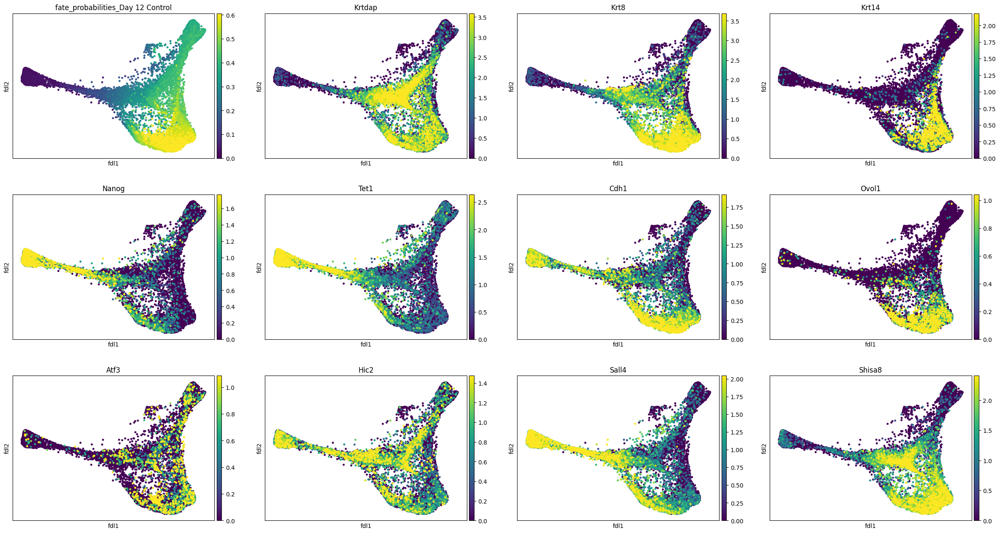

In [23]:
# Visualize genes of interest

terminal_state = "Day 12 Control"
scanpy.pl.embedding(
    adata,
    basis="fdl",
    color=[f"fate_probabilities_{terminal_state}"] + genes_of_interest,
    color_map="viridis",
    s=50,
    ncols=4,
    vmax="p96",
)

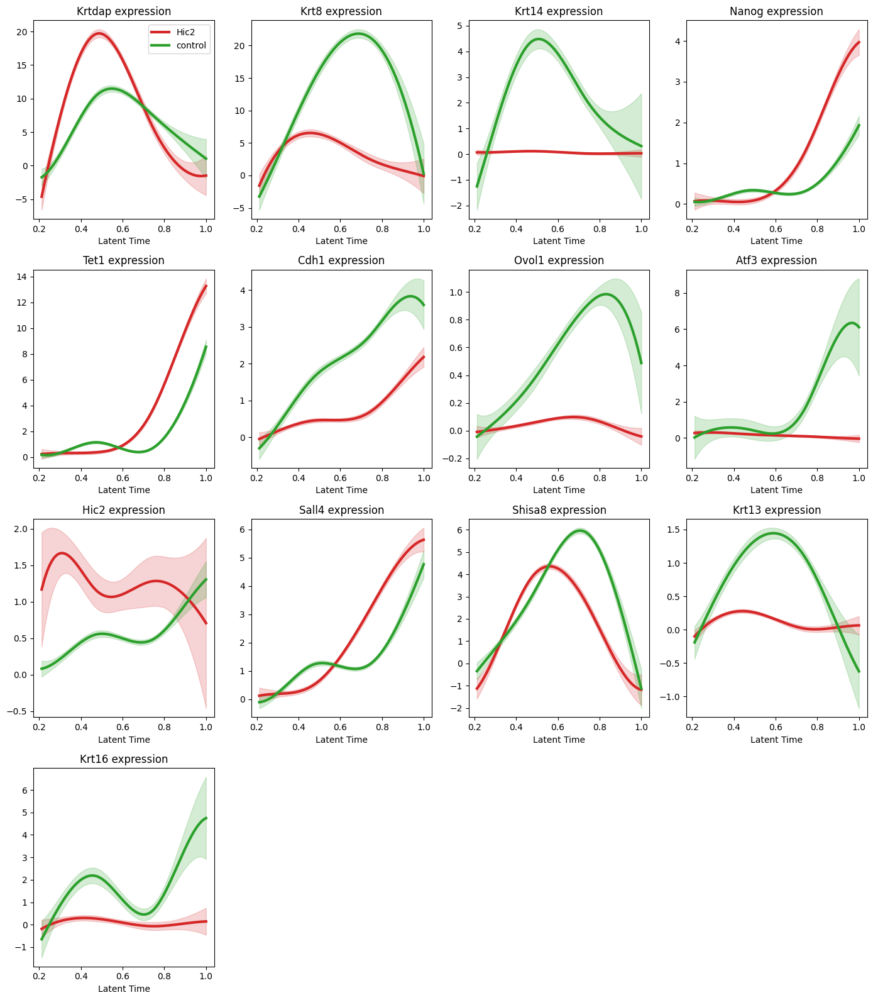

In [ ]:
plot_grouped_gene_trend(
    adata, 
    genes_of_interest, 
    group_key="group", 
    layer="spliced", 
    groups=["Hic2", "control"]
)

To use GAM, pygam is needed

To use GAMR, r-base, rpy2 and mgcv are needed

  0%|          | 0/11 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


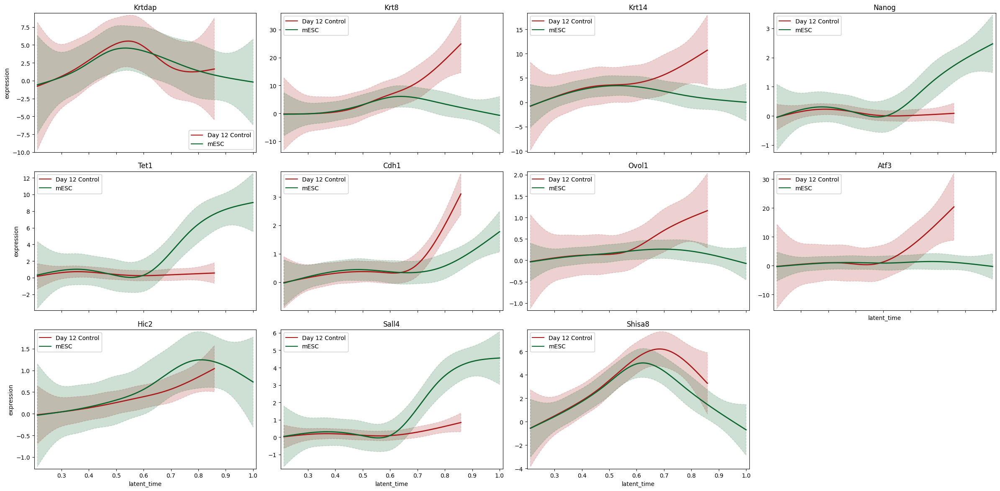

In [32]:
# Control and Hic2 group

reprogramming_group_indices = (adata.obs["group"] == "control") | (adata.obs["group"] == "Hic2")

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0) # Pygam can also be used with GAM instead of GAMR

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    genes=genes_of_interest,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/11 [00:00<?, ?gene/s]

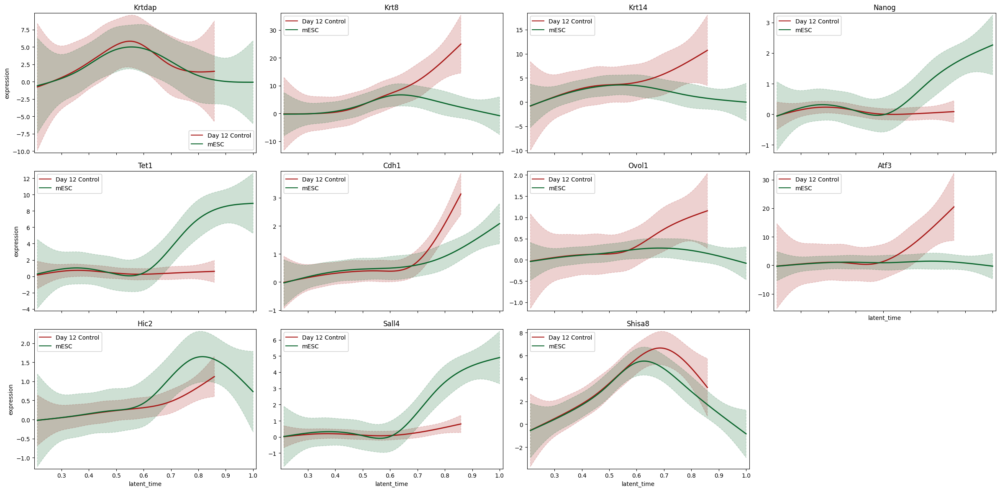

In [41]:
# Only control

control_indices = adata.obs["group"] == "control"

model = cellrank.models.GAMR(adata[control_indices], n_knots=6, smoothing_penalty=10.0)

cellrank.pl.gene_trends(
    adata[control_indices],
    model=model,
    genes=genes_of_interest,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/11 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


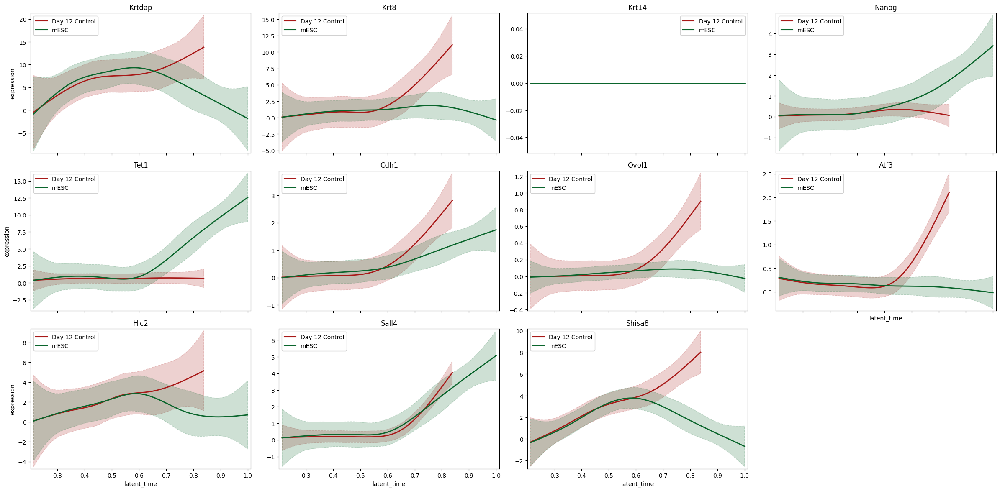

In [34]:
# Only Hic2

hic2_indices = adata.obs["group"] == "Hic2"

model = cellrank.models.GAMR(adata[hic2_indices], n_knots=6, smoothing_penalty=10.0)

cellrank.pl.gene_trends(
    adata[hic2_indices],
    model=model,
    genes=genes_of_interest,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


### Expression trends for dead end drivers

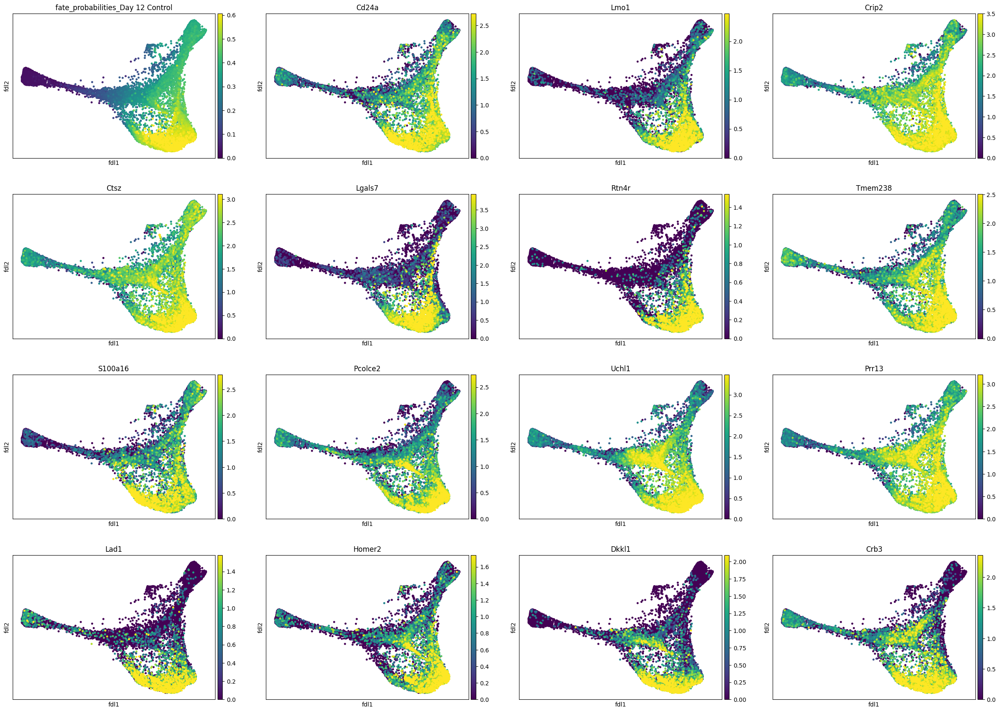

In [27]:
# Visualize driver genes for day 12 control

terminal_state = "Day 12 Control"
scanpy.pl.embedding(
    adata,
    basis="fdl",
    color=[f"fate_probabilities_{terminal_state}"] + list(driver_df.sort_values(f"{terminal_state}_corr", ascending=False).index[:15]),
    color_map="viridis",
    s=50,
    ncols=4,
    vmax="p96",
)

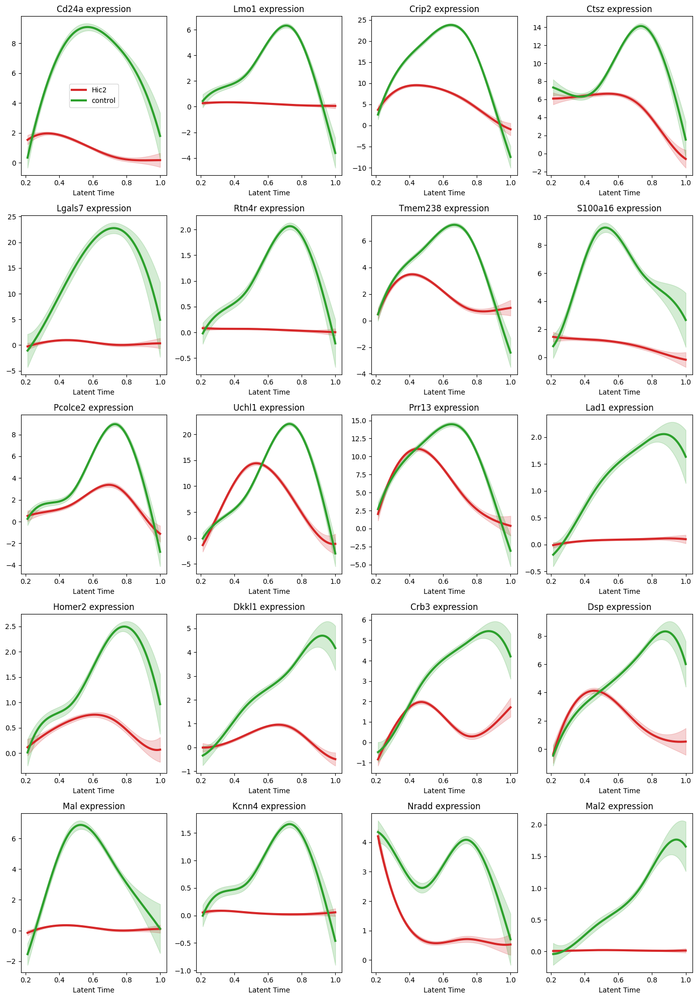

In [38]:
# Expression of drivers
control_driver_genes = driver_df.sort_values(f"Day 12 Control_corr", ascending=False).head(20).index

plot_grouped_gene_trend(
    adata, 
    control_driver_genes, 
    group_key="group", 
    layer="spliced", 
    groups=["Hic2", "control"]
)

  0%|          | 0/20 [00:00<?, ?gene/s]

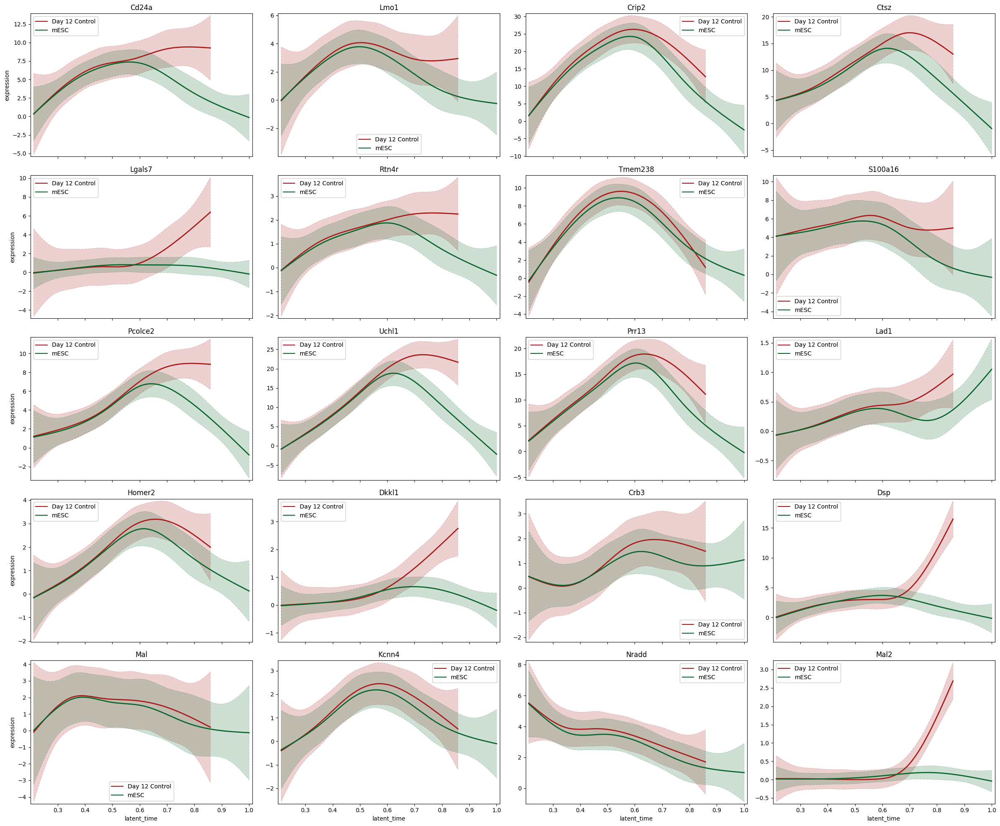

In [29]:
# The 20 strongest drivers of dead end in only control and Hic2

reprogramming_group_indices = (adata.obs["group"] == "control") | (adata.obs["group"] == "Hic2")

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0)

dead_end = "Day 12 Control"
cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    genes=driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(20).index,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/20 [00:00<?, ?gene/s]

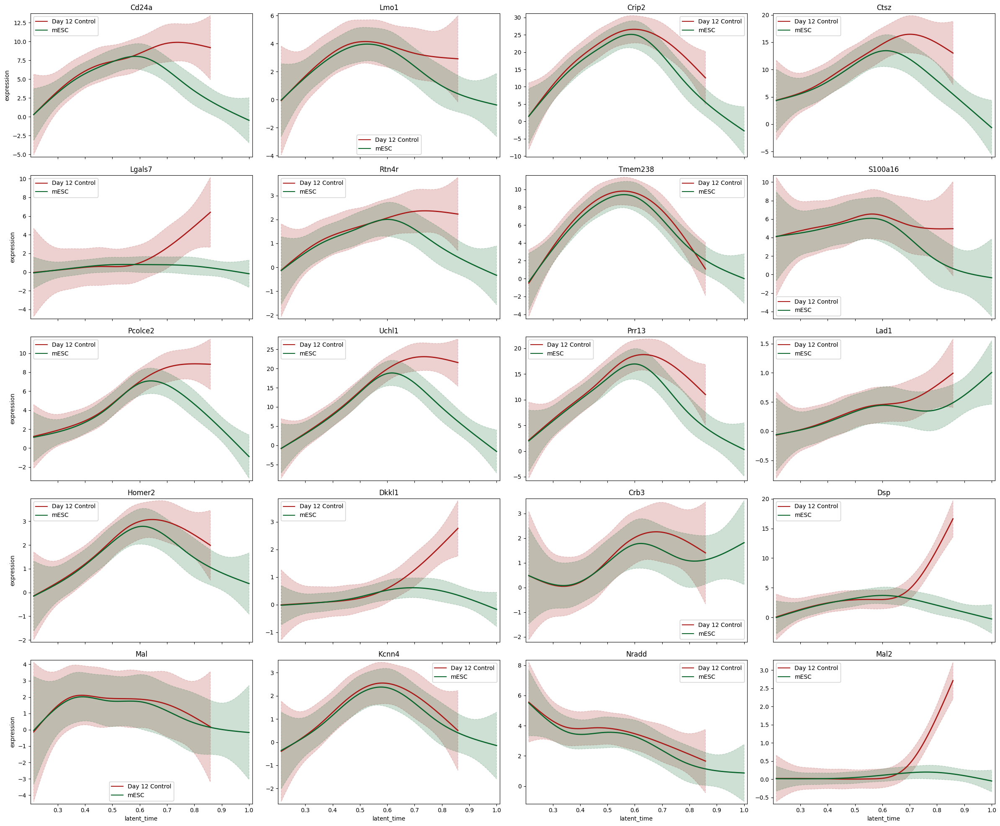

In [44]:
# Drivers with only control

model = cellrank.models.GAMR(adata[adata.obs["group"] == "control"], n_knots=6, smoothing_penalty=10.0)

dead_end = "Day 12 Control"
cellrank.pl.gene_trends(
    adata[control_indices],
    model=model,
    genes=driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(20).index,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/20 [00:00<?, ?gene/s]

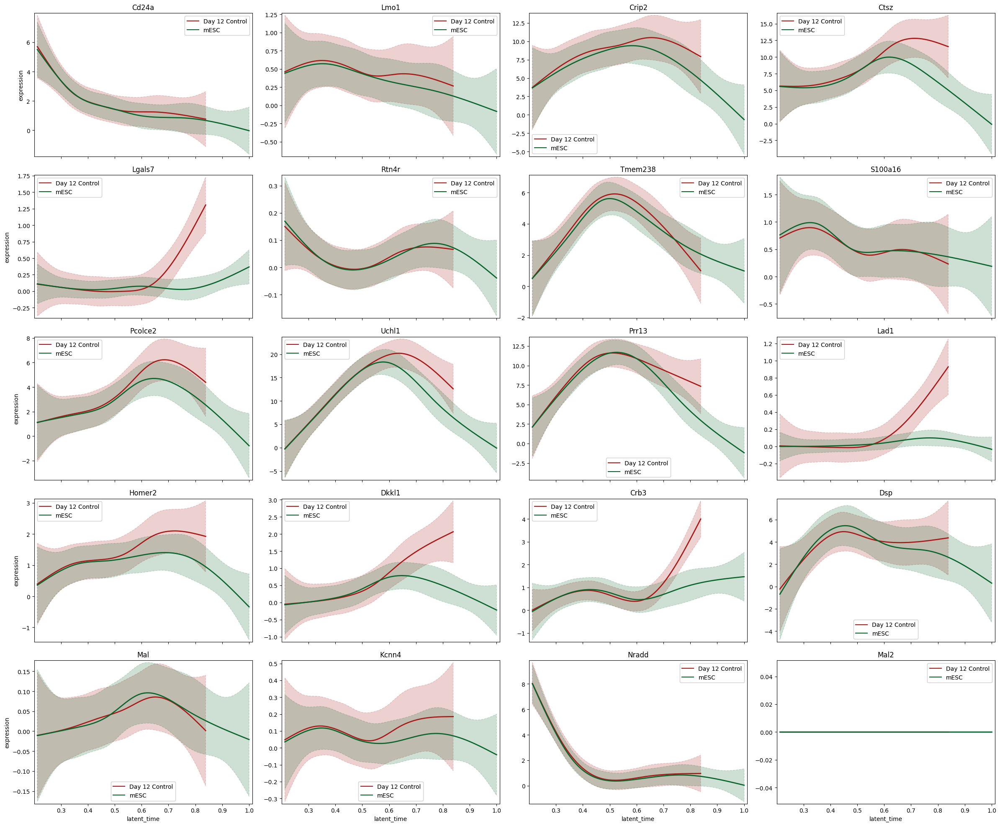

In [44]:
# Drivers with only Hic2

hic2_indices = adata.obs["group"] == "Hic2"
model = cellrank.models.GAMR(adata[hic2_indices], n_knots=6, smoothing_penalty=10.0)

dead_end = "Day 12 Control"
cellrank.pl.gene_trends(
    adata[hic2_indices],
    model=model,
    genes=driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(20).index,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/40 [00:00<?, ?gene/s]

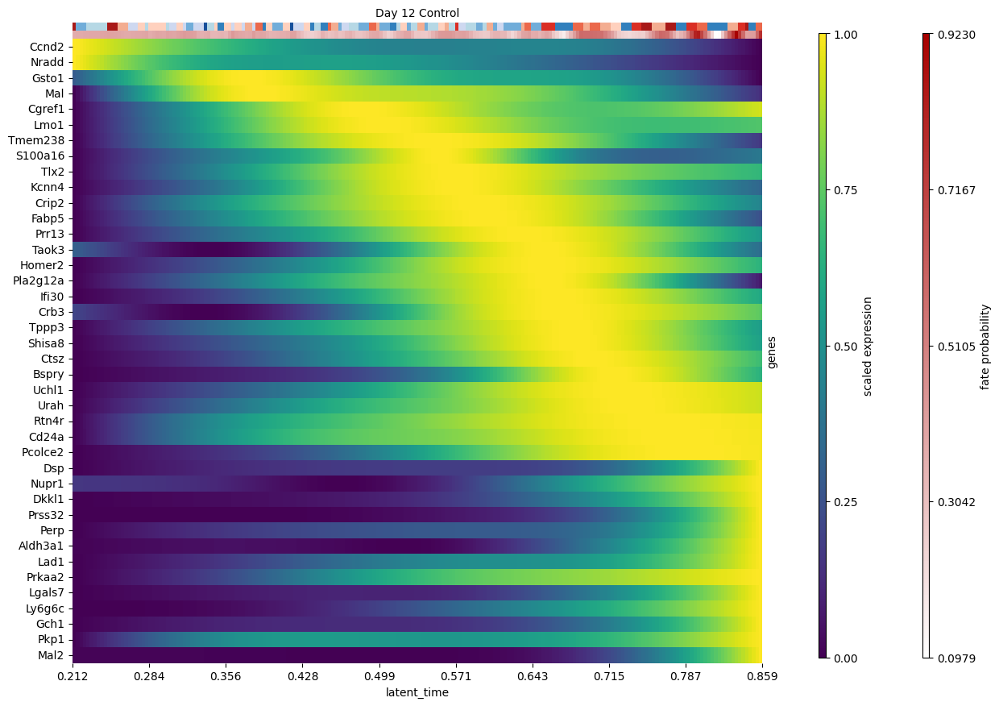

In [46]:
# Heatmap for dead-end related genes

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0)
cellrank.pl.heatmap(
    adata[reprogramming_group_indices],
    model=model,  # use the model from before
    lineages=dead_end,
    cluster_key="sample",
    show_fate_probabilities=True,
    data_key="spliced",
    genes=driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(40).index,
    time_key="latent_time",
    figsize=(12, 10),
    show_all_genes=True,
    weight_threshold=(1e-3, 1e-3),
)


### Expression trends for iPSC drivers

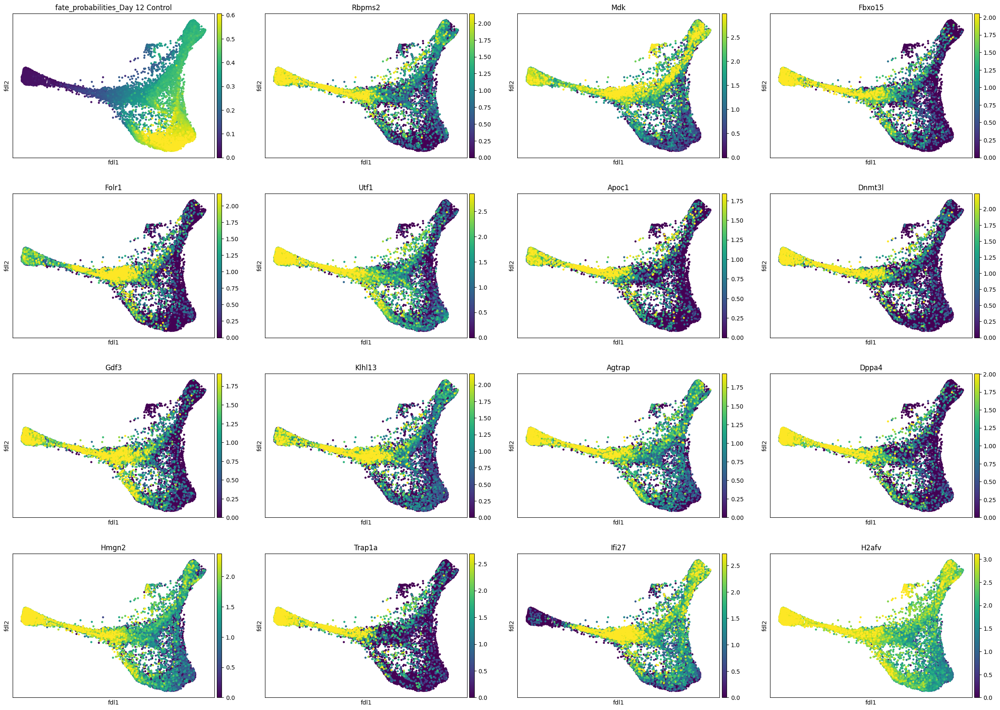

In [48]:
# Visualize driver genes for iPSC

terminal_state = "Day 12 Control"
scanpy.pl.embedding(
    adata,
    basis="fdl",
    color=[f"fate_probabilities_{terminal_state}"] + list(driver_df.sort_values(f"{terminal_state}_corr", ascending=True).index[:15]),
    color_map="viridis",
    s=50,
    ncols=4,
    vmax="p96",
)

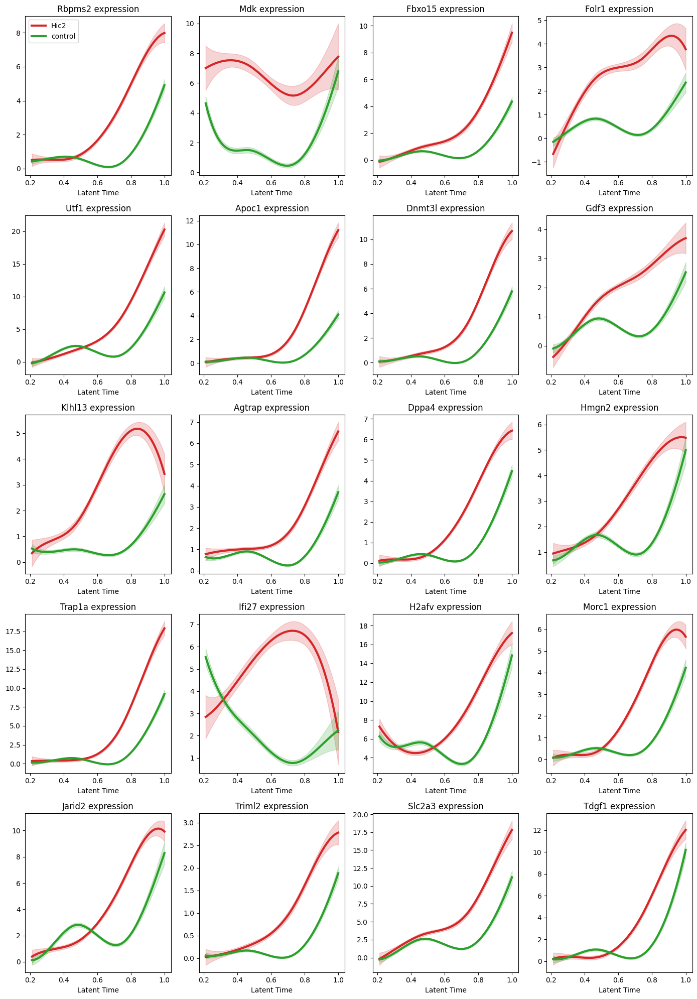

In [49]:
# Expression of reprogramming drivers
mesc_driver_genes = driver_df.sort_values(f"Day 12 Control_corr", ascending=True).head(20).index

plot_grouped_gene_trend(
    adata, 
    mesc_driver_genes, 
    group_key="group", 
    layer="spliced", 
    groups=["Hic2", "control"]
)

  0%|          | 0/20 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


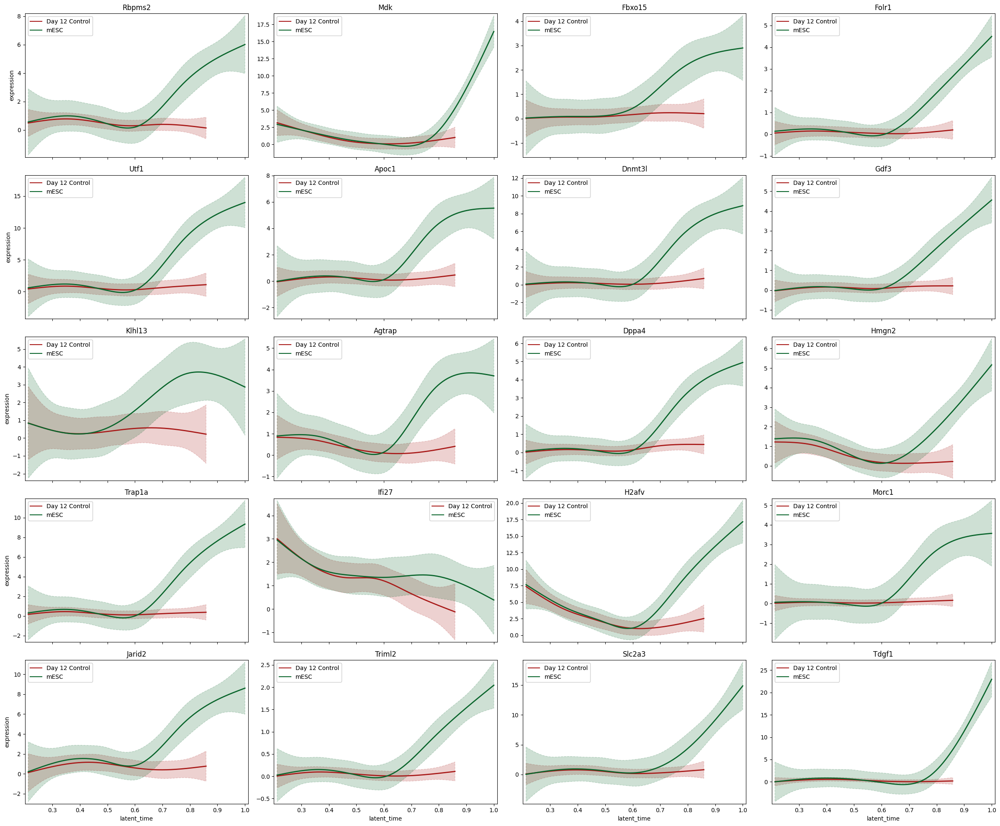

In [50]:
# The 20 strongest drivers of reprogramming in only control and Hic2

reprogramming_group_indices = (adata.obs["group"] == "control") | (adata.obs["group"] == "Hic2")

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0)

dead_end = "Day 12 Control"
cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    genes=driver_df.sort_values(f"{dead_end}_corr", ascending=True).head(20).index,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/20 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


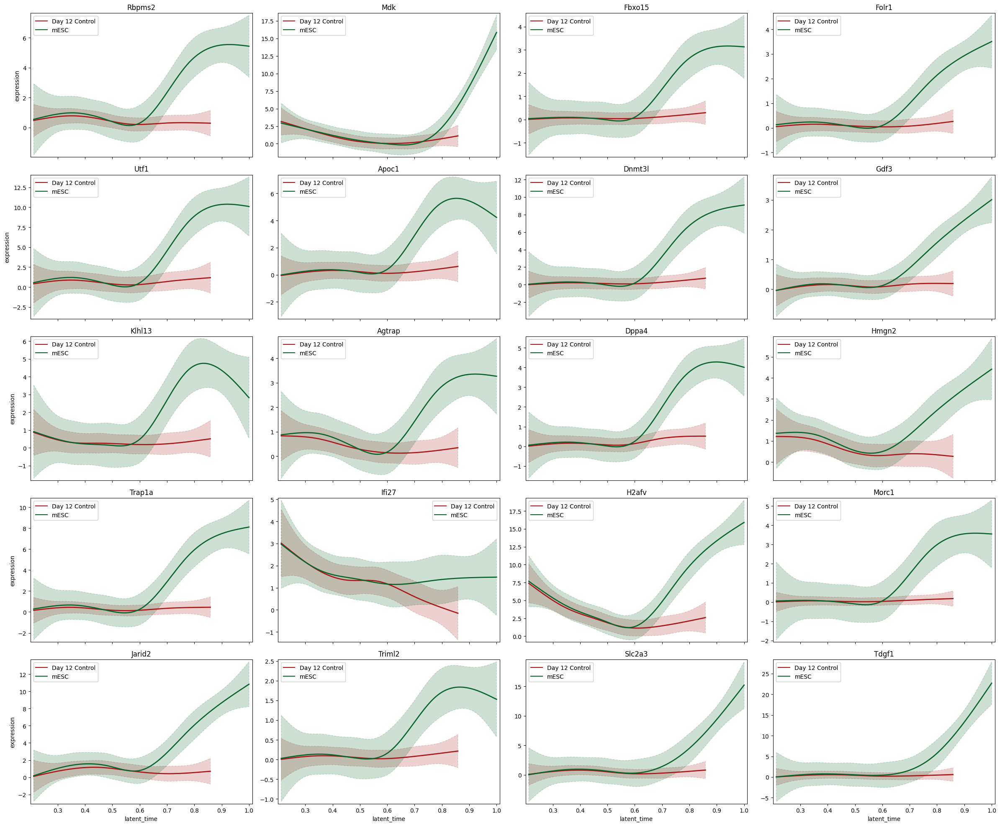

In [51]:
# The 20 strongest drivers of reprogramming in only control

model = cellrank.models.GAMR(adata[control_indices], n_knots=6, smoothing_penalty=10.0)

dead_end = "Day 12 Control"
cellrank.pl.gene_trends(
    adata[control_indices],
    model=model,
    genes=driver_df.sort_values(f"{dead_end}_corr", ascending=True).head(20).index,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/20 [00:00<?, ?gene/s]

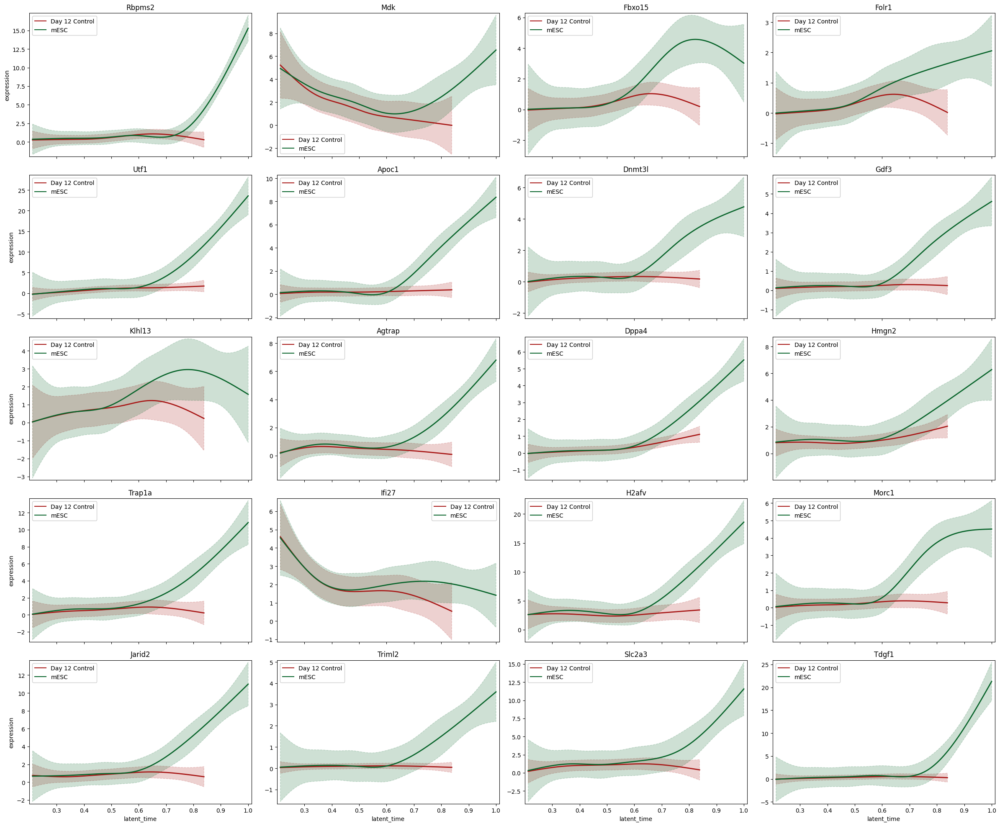

In [52]:
# The 20 strongest drivers of reprogramming in only Hic2

model = cellrank.models.GAMR(adata[hic2_indices], n_knots=6, smoothing_penalty=10.0)

dead_end = "Day 12 Control"
cellrank.pl.gene_trends(
    adata[hic2_indices],
    model=model,
    genes=driver_df.sort_values(f"{dead_end}_corr", ascending=True).head(20).index,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)


  0%|          | 0/40 [00:00<?, ?gene/s]

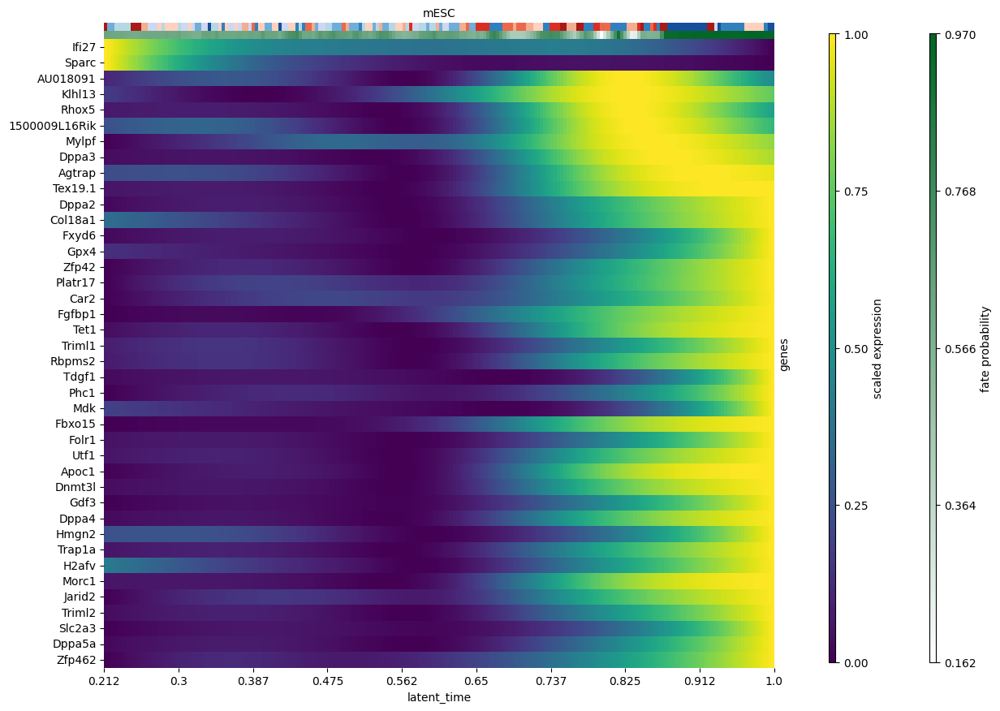

In [53]:
# Heatmap for completed reprogramming

terminal_state = "mESC"
model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0)
cellrank.pl.heatmap(
    adata[reprogramming_group_indices],
    model=model,  # use the model from before
    lineages=terminal_state,
    cluster_key="sample",
    show_fate_probabilities=True,
    data_key="spliced",
    genes=driver_df.sort_values(f"{terminal_state}_corr", ascending=False).head(40).index,
    time_key="latent_time",
    figsize=(12, 10),
    show_all_genes=True,
    weight_threshold=(1e-3, 1e-3),
)


## Dead end driver gene clusters

Clustering requires the leidenalg package

  0%|          | 0/2000 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0
Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x727255d3f420>
Traceback (most recent call last):
  File "/home/avesta/m26_losu/miniconda3/envs/velocity/lib/python3.12/site-packages/threadpoolct

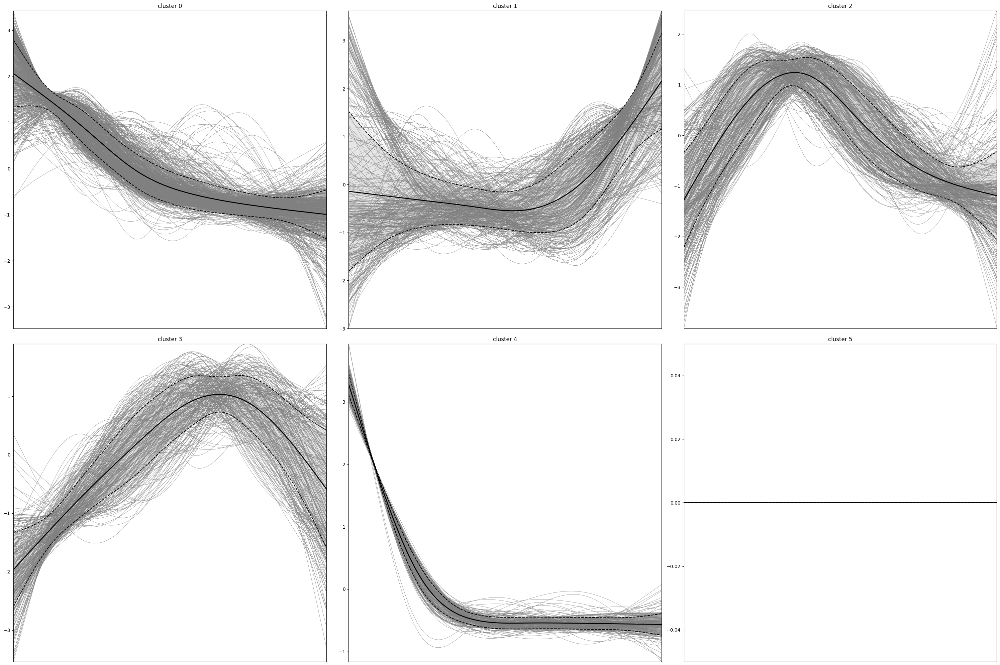

In [56]:
# Cluster for dead end

model = cellrank.models.GAMR(adata, n_knots=6, smoothing_penalty=10.0)
cellrank.pl.cluster_trends(
    adata,
    lineage=dead_end,
    model=model,  # use the model from before
    data_key="spliced",
    genes=adata[:, adata.var["highly_variable"]].var_names,
    time_key="latent_time",
    weight_threshold=(1e-3, 1e-3),
    n_jobs=16,
    random_state=0,
    clustering_kwargs={"resolution": 0.2, "random_state": 0},
    neighbors_kwargs={"random_state": 0},
)


In [57]:
# Copy gene clusters to separate anndata objects

dead_end_adata = adata.uns[f"lineage_{dead_end}_trend"].copy()
cols = ["means", "dispersions"]
dead_end_adata.obs = dead_end_adata.obs.merge(
    right=adata.var[cols], how="left", left_index=True, right_index=True
)

print(dead_end_adata)

AnnData object with n_obs × n_vars = 2000 × 200
    obs: 'clusters', 'means', 'dispersions'
    var: 'x_test'
    uns: 'pca', 'neighbors', 'clusters'
    obsm: 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


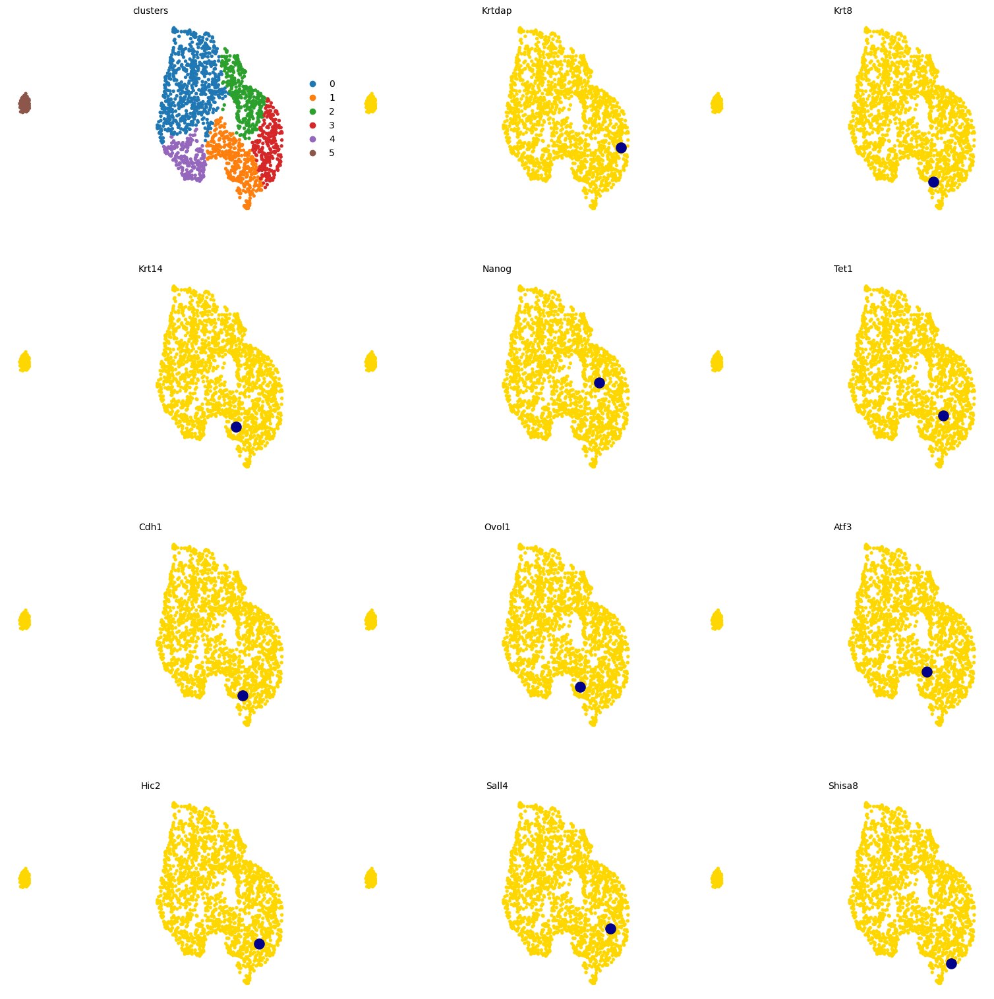

In [59]:
# Visualize where in the clusters genes of interest are found

# retrieve their indices for plotting
indices = [numpy.where(numpy.in1d(dead_end_adata.obs_names, gene))[0][0] for gene in genes_of_interest]
title = ["clusters"] + genes_of_interest

scvelo.pl.scatter(
    dead_end_adata, c=["clusters"] + indices, title=title, ncols=3, legend_loc="right"
)

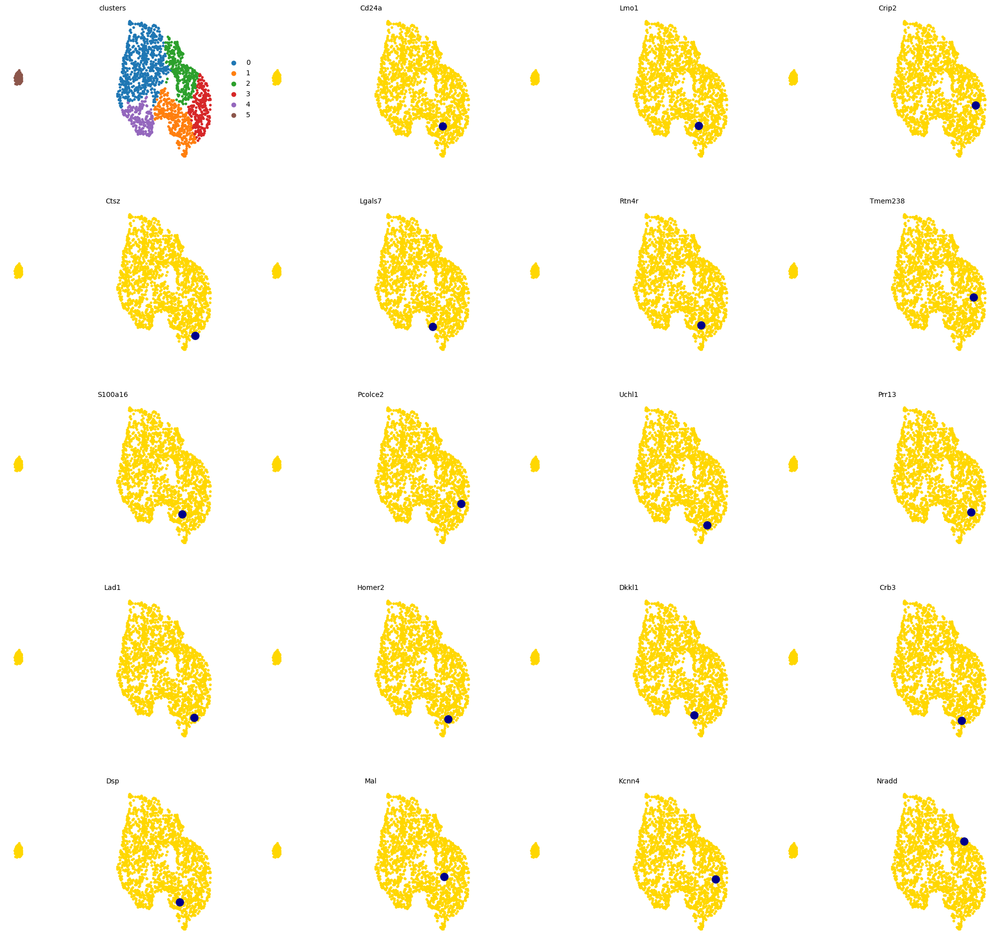

In [ ]:
# Visualize where dead end drivers are found
scanpy.tl.umap(dead_end_adata, random_state=0)

# retrieve their indices for plotting
driver_genes = list(driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(19).index)
indices = [numpy.where(numpy.in1d(dead_end_adata.obs_names, gene))[0][0] for gene in driver_genes]
title = ["clusters"] + driver_genes

scvelo.pl.scatter(
    dead_end_adata, c=["clusters"] + indices, title=title, ncols=4, legend_loc="right"
)

Most genes have late peaks, but Crip2, Nradd and some other genes have intermediate peaks. Nradd promotes apoptosis. Genes with similar expression dynamics can be found.

  0%|          | 0/11 [00:00<?, ?gene/s]

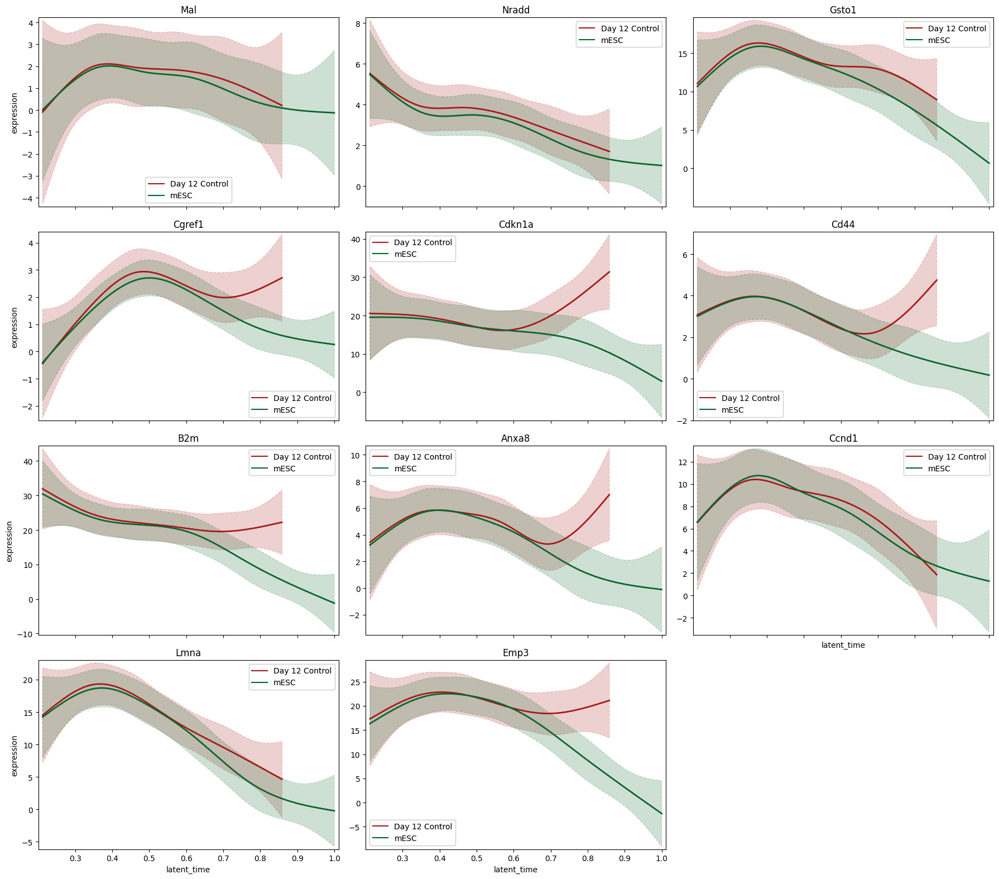

In [62]:
# Find driver genes peaking in the middle

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0)
mid_peak_genes = dead_end_adata[dead_end_adata.obs["clusters"] == "2"]
mid_peak_drivers = []

for driver_gene in driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(100).index:
    if driver_gene in mid_peak_genes.obs.index:
        mid_peak_drivers.append(driver_gene)

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    cell_color="sample",
    data_key="spliced",
    genes=mid_peak_drivers,
    same_plot=True,
    ncols=3,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/4 [00:00<?, ?gene/s]

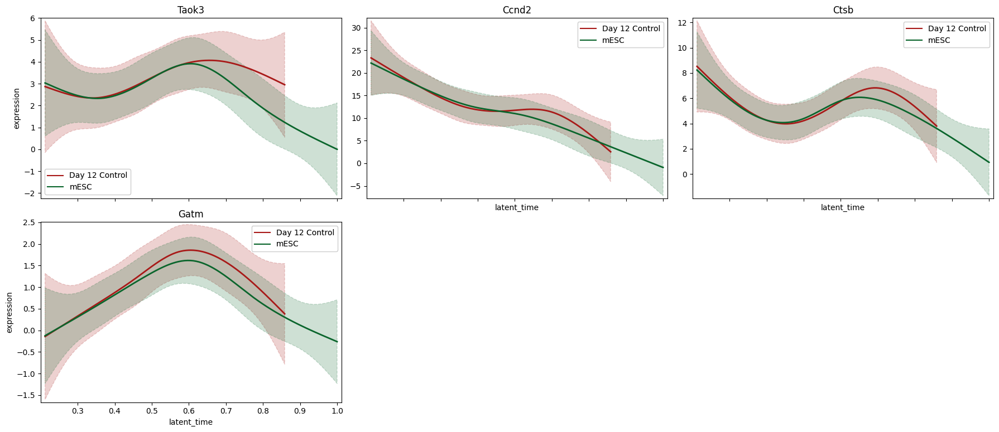

In [63]:
# Find driver genes with slowly decreasing expression

mid_peak_genes = dead_end_adata[dead_end_adata.obs["clusters"] == "0"]
mid_peak_drivers = []

for driver_gene in driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(100).index:
    if driver_gene in mid_peak_genes.obs.index:
        mid_peak_drivers.append(driver_gene)

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    cell_color="sample",
    data_key="spliced",
    genes=mid_peak_drivers,
    same_plot=True,
    ncols=3,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/22 [00:00<?, ?gene/s]

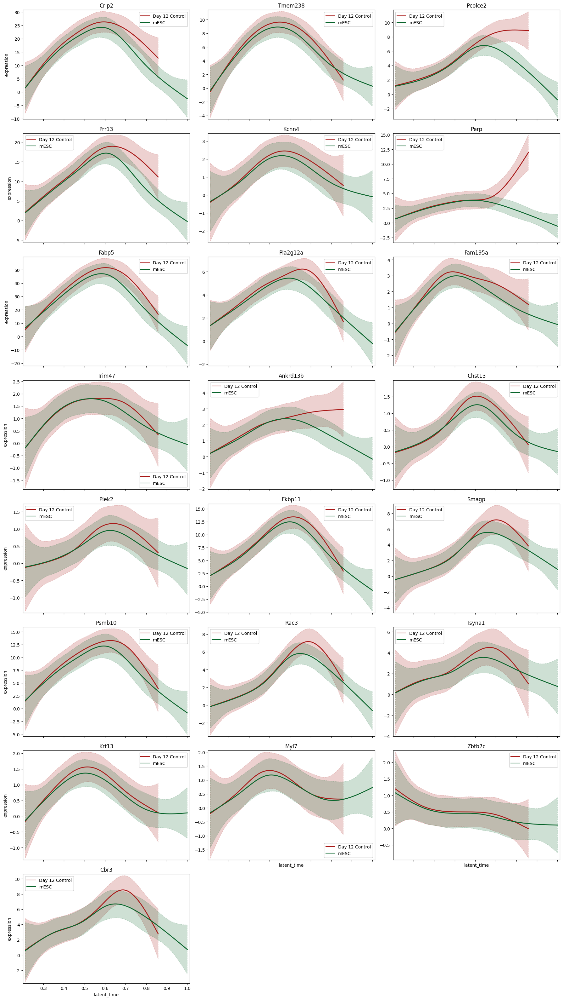

In [65]:
# Find driver genes with U-shaped expression and a later peak

mid_peak_genes = dead_end_adata[dead_end_adata.obs["clusters"] == "3"]
mid_peak_drivers = []

for driver_gene in driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(100).index: # None of the top 100 drivers have early dips, and only 2 in the top 200
    if driver_gene in mid_peak_genes.obs.index:
        mid_peak_drivers.append(driver_gene)

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    cell_color="sample",
    data_key="spliced",
    genes=mid_peak_drivers,
    same_plot=True,
    ncols=3,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/2 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


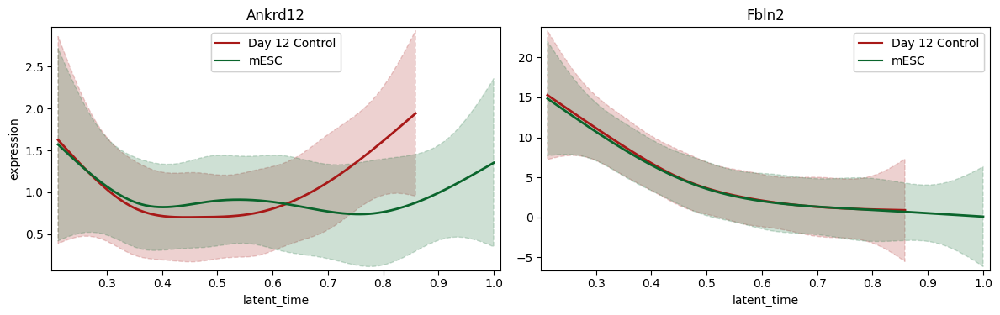

In [69]:
# Find driver genes with a quick dip

mid_peak_genes = dead_end_adata[dead_end_adata.obs["clusters"] == "4"]
mid_peak_drivers = []

for driver_gene in driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(200).index:
    if driver_gene in mid_peak_genes.obs.index:
        mid_peak_drivers.append(driver_gene)

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    cell_color="sample",
    data_key="spliced",
    genes=mid_peak_drivers,
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/32 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


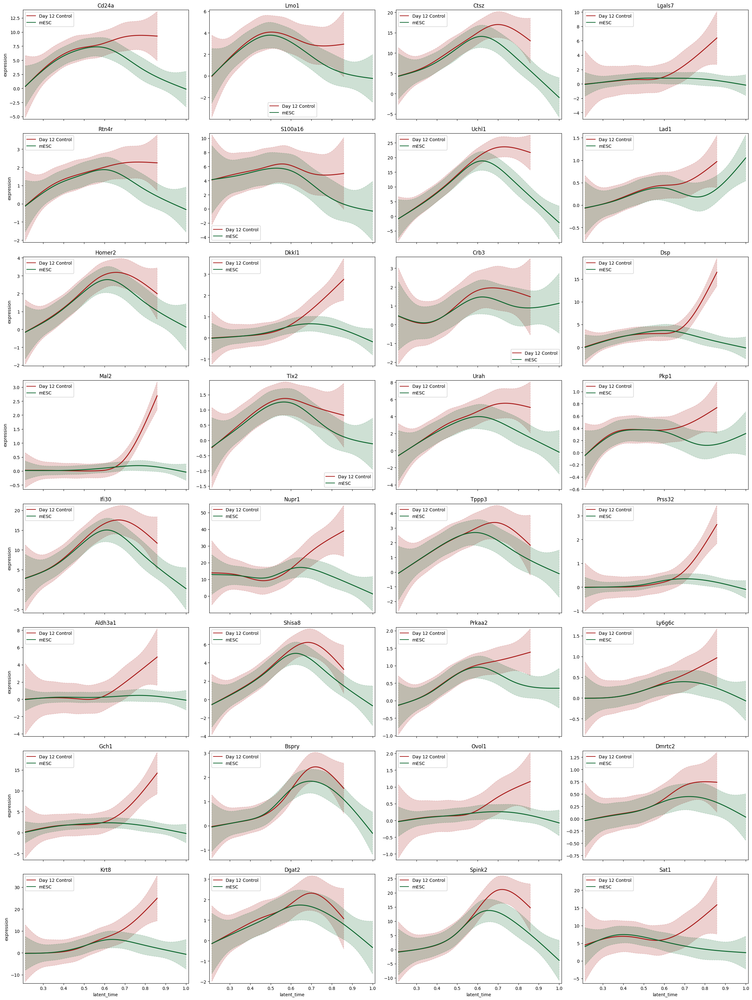

In [66]:
# Find driver genes increasing quickly at the end of the trajectory. Most drivers have this type of expression

mid_peak_genes = dead_end_adata[dead_end_adata.obs["clusters"] == "1"]
mid_peak_drivers = []

for driver_gene in driver_df.sort_values(f"{dead_end}_corr", ascending=False).head(50).index:
    if driver_gene in mid_peak_genes.obs.index:
        mid_peak_drivers.append(driver_gene)

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    cell_color="sample",
    data_key="spliced",
    genes=mid_peak_drivers,
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

## Reprogramming driver gene clusters

  0%|          | 0/2000 [00:00<?, ?gene/s]

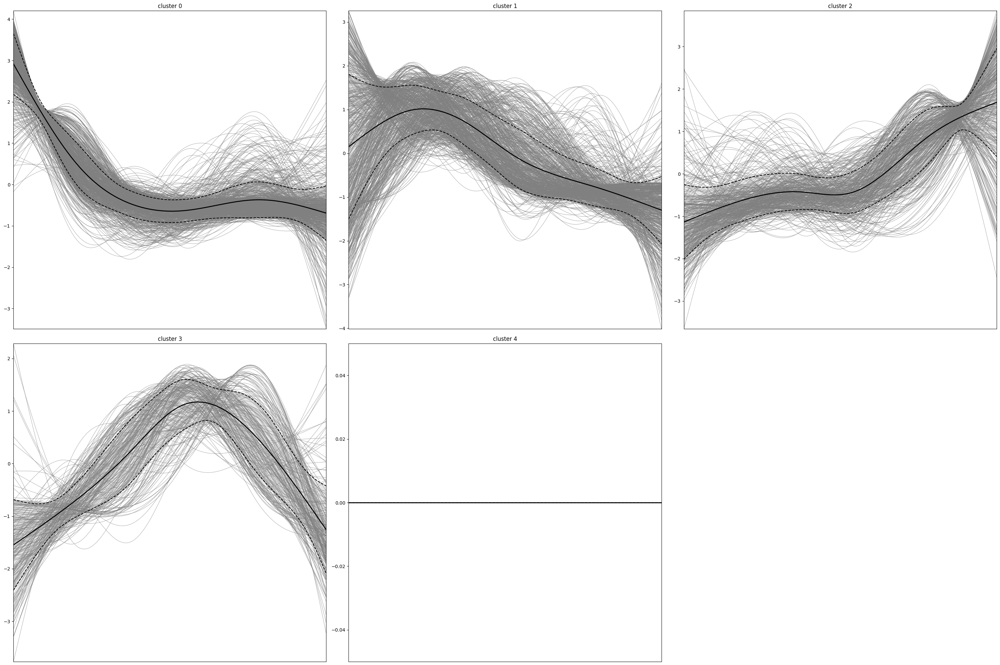

In [70]:
# Cluster for mESC

model = cellrank.models.GAMR(adata, n_knots=6, smoothing_penalty=10.0)
cellrank.pl.cluster_trends(
    adata,
    lineage="mESC",
    model=model,  # use the model from before
    data_key="spliced",
    genes=adata[:, adata.var["highly_variable"]].var_names,
    time_key="latent_time",
    weight_threshold=(1e-3, 1e-3),
    n_jobs=16,
    random_state=0,
    clustering_kwargs={"resolution": 0.2, "random_state": 0},
    neighbors_kwargs={"random_state": 0},
)


In [71]:
# Copy to separate Anndata

mESC_adata = adata.uns["lineage_mESC_trend"].copy()
mESC_adata.obs = mESC_adata.obs.merge(
    right=adata.var[cols], how="left", left_index=True, right_index=True
)

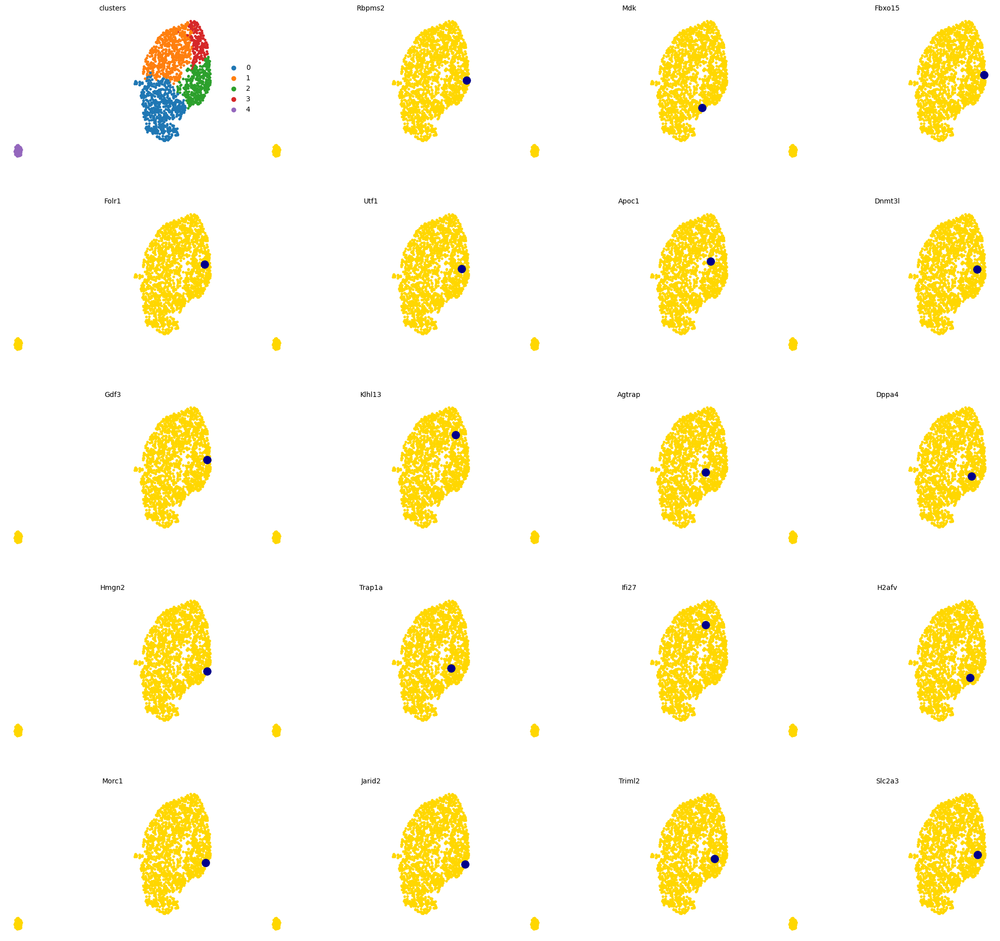

In [73]:
# Visualize where driver genes are found

scanpy.tl.umap(mESC_adata, random_state=0)

# retrieve their indices for plotting
driver_genes = list(driver_df.sort_values(f"{dead_end}_corr", ascending=True).head(19).index)
indices = [numpy.where(numpy.in1d(mESC_adata.obs_names, gene))[0][0] for gene in driver_genes]
title = ["clusters"] + driver_genes

scvelo.pl.scatter(
    mESC_adata, c=["clusters"] + indices, title=title, ncols=4, legend_loc="right"
)

Most drivers are in cluster 2 with late peaks

  0%|          | 0/3 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


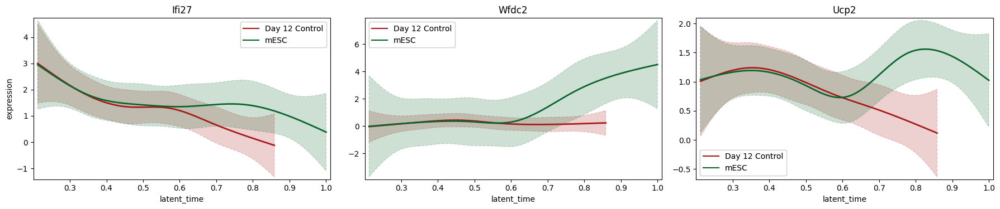

In [74]:
# Find driver genes with middle peaks

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0)

mid_peak_genes = mESC_adata[mESC_adata.obs["clusters"] == "1"]
mid_peak_drivers = []

for driver_gene in driver_df.sort_values(f"{dead_end}_corr", ascending=True).head(100).index: # None of the top 100 drivers have early dips, and only 2 in the top 200
    if driver_gene in mid_peak_genes.obs.index:
        mid_peak_drivers.append(driver_gene)

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    cell_color="sample",
    data_key="spliced",
    genes=mid_peak_drivers,
    same_plot=True,
    ncols=3,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/8 [00:00<?, ?gene/s]

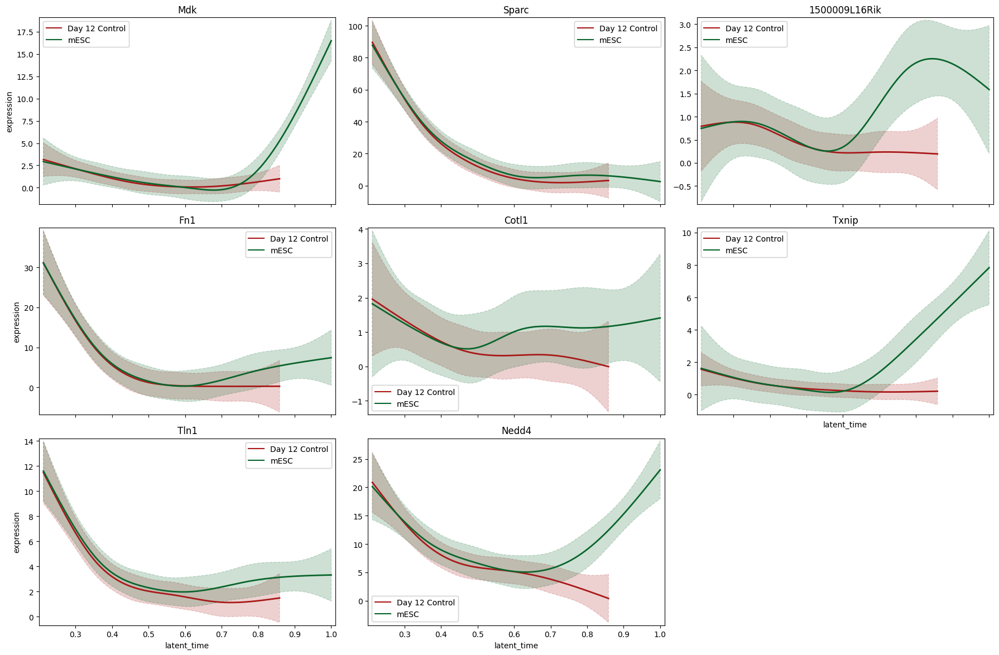

In [75]:
# Find driver genes with early peaks

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0)

mid_peak_genes = mESC_adata[mESC_adata.obs["clusters"] == "0"]
mid_peak_drivers = []

for driver_gene in driver_df.sort_values(f"{dead_end}_corr", ascending=True).head(100).index: # None of the top 100 drivers have early dips, and only 2 in the top 200
    if driver_gene in mid_peak_genes.obs.index:
        mid_peak_drivers.append(driver_gene)

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    cell_color="sample",
    data_key="spliced",
    genes=mid_peak_drivers,
    same_plot=True,
    ncols=3,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

# Trends for drivers identified with ChipSeq

## Dead end drivers

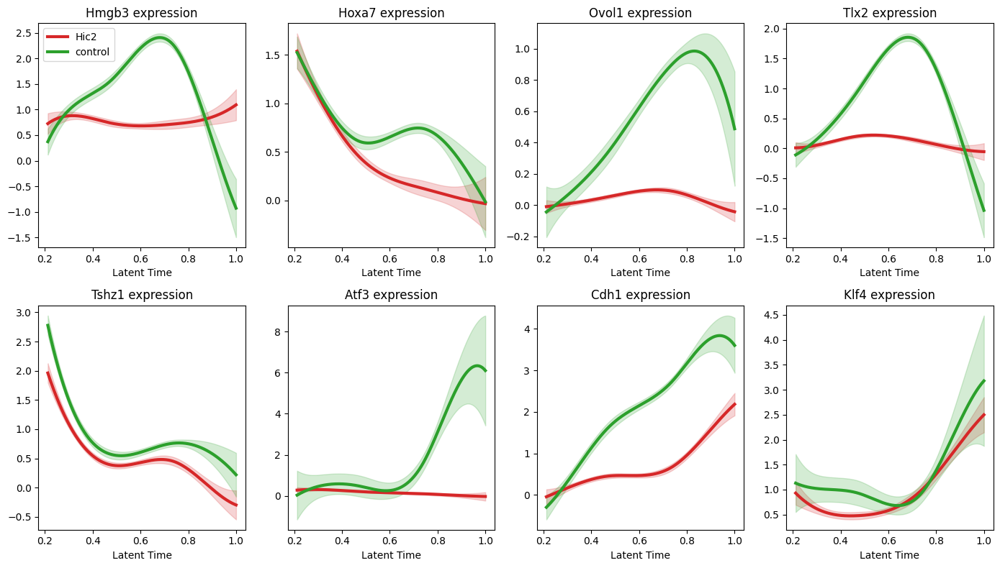

In [65]:
# Expression of dead end drivers

dead_end_tfs = ['Hmgb3', 'Hoxa7', 'Ovol1', 'Tlx2', 'Tshz1', "Atf3", "Cdh1", "Klf4"]

plot_grouped_gene_trend(
    adata, 
    dead_end_tfs, 
    group_key="group", 
    layer="spliced", 
    groups=["Hic2", "control"]
)

  0%|          | 0/8 [00:00<?, ?gene/s]

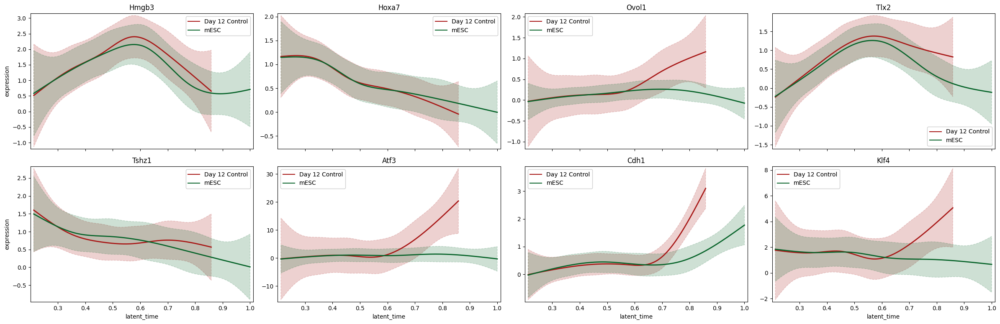

In [66]:
# Dead end drivers

reprogramming_group_indices = (adata.obs["group"] == "control") | (adata.obs["group"] == "Hic2")

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0) # Pygam can also be used with GAM instead of GAMR

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    genes=dead_end_tfs,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/8 [00:00<?, ?gene/s]

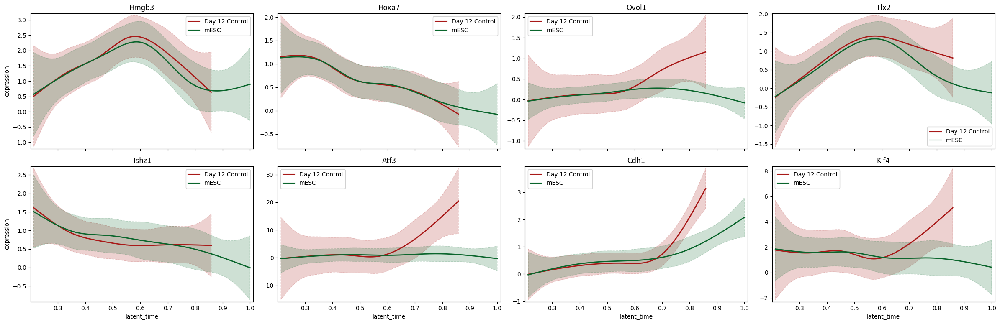

In [67]:
# Dead end drivers in control

model = cellrank.models.GAMR(adata[control_indices], n_knots=6, smoothing_penalty=10.0) # Pygam can also be used with GAM instead of GAMR

cellrank.pl.gene_trends(
    adata[control_indices],
    model=model,
    genes=dead_end_tfs,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/8 [00:00<?, ?gene/s]

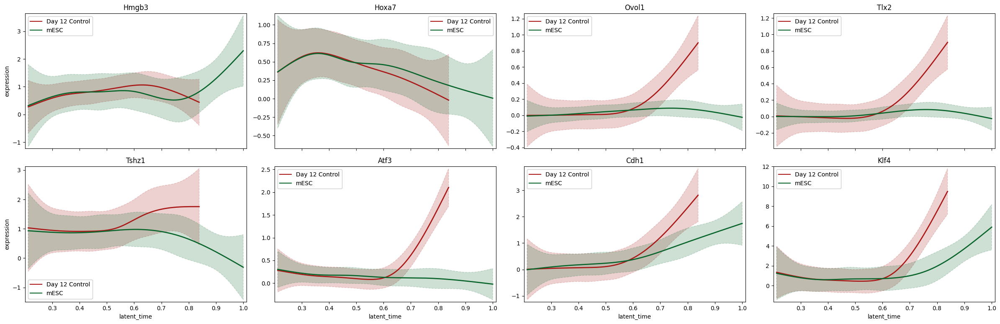

In [69]:
# Dead end drivers in Hic2

model = cellrank.models.GAMR(adata[hic2_indices], n_knots=6, smoothing_penalty=10.0) # Pygam can also be used with GAM instead of GAMR

cellrank.pl.gene_trends(
    adata[hic2_indices],
    model=model,
    genes=dead_end_tfs,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

Only Ovol1, Cdh1 and Tlx2 look like a drivers for the dead end in control cells. Interestingly, Tlx2 has an inverse U-shape in control cells only. In Hic2 cells, it is only high in cells reaching the dead end.

## Stem cell drivers

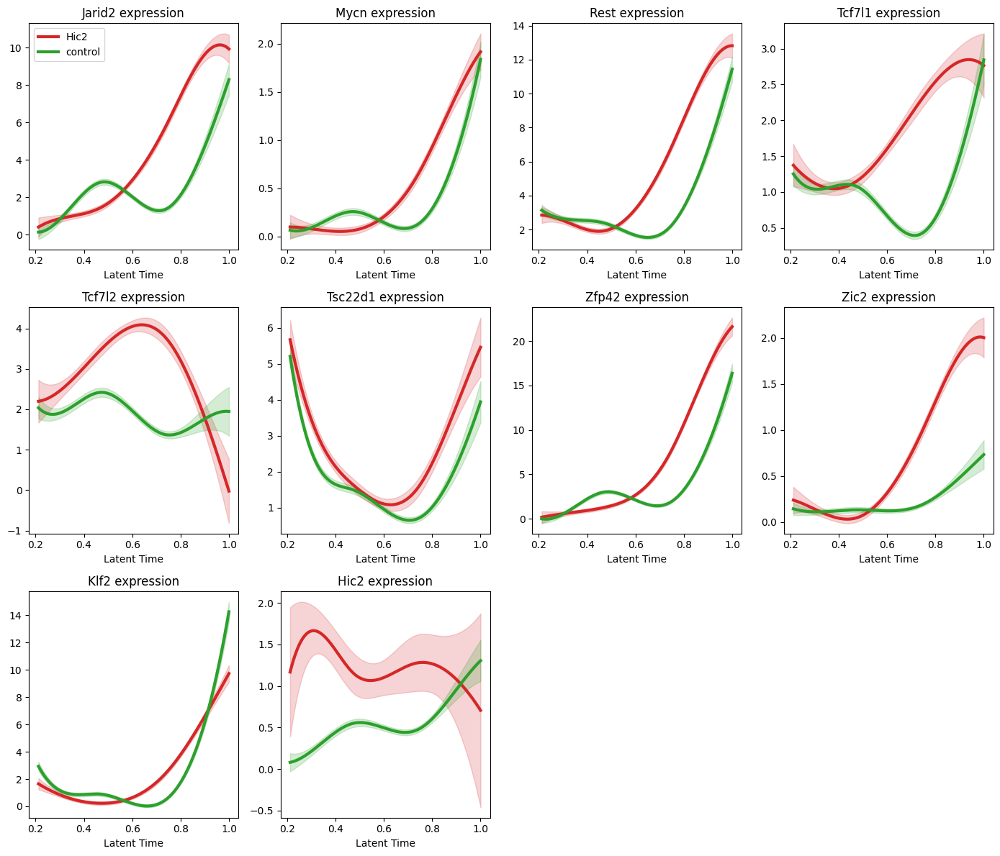

In [57]:
# Expression of reprogramming drivers

stem_cell_tfs = ['Jarid2', 'Mycn', 'Rest', 'Tcf7l1', 'Tcf7l2', 'Tsc22d1', 'Zfp42', 'Zic2', "Klf2"]

plot_grouped_gene_trend(
    adata,
    stem_cell_tfs+["Hic2"],
    group_key="group",
    layer="spliced",
    groups=["Hic2", "control"]
)

The inverse U-shape for the control, such as for Zfp42, suggests correlation but not causation. Expression increases with time in cells becoming stem cells. The dip in the control is caused by some cells reaching the dead end.

  0%|          | 0/9 [00:00<?, ?gene/s]

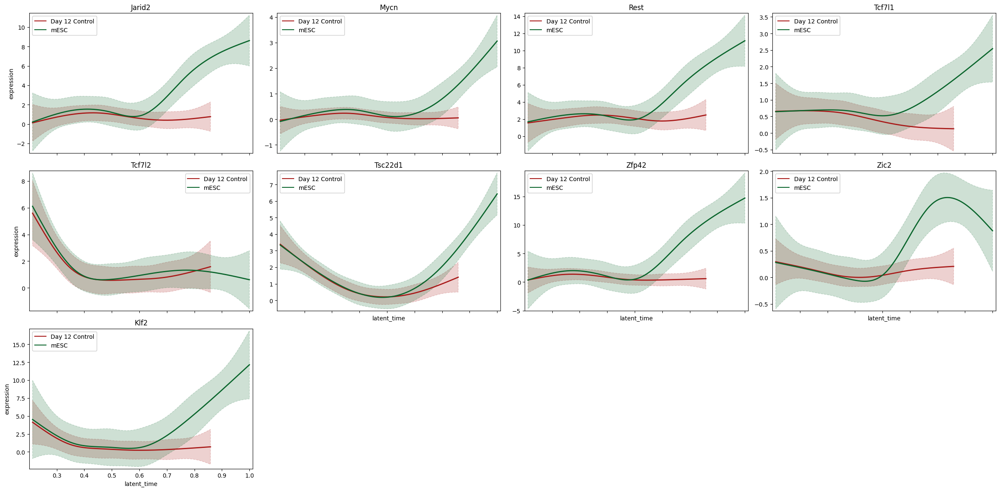

In [58]:
# Stem cell drivers

model = cellrank.models.GAMR(adata[reprogramming_group_indices], n_knots=6, smoothing_penalty=10.0) # Pygam can also be used with GAM instead of GAMR

cellrank.pl.gene_trends(
    adata[reprogramming_group_indices],
    model=model,
    genes=stem_cell_tfs,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/9 [00:00<?, ?gene/s]

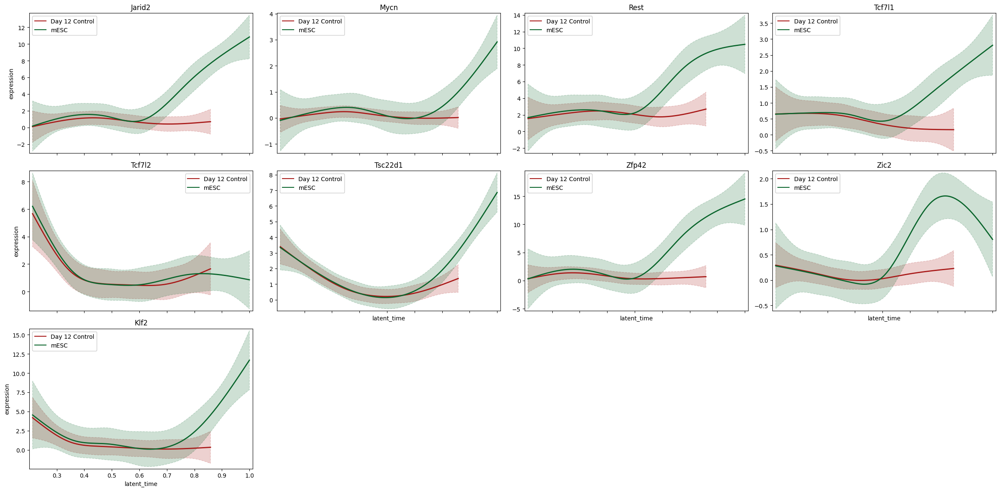

In [59]:
# Stem cell drivers in only control

model = cellrank.models.GAMR(adata[control_indices], n_knots=6, smoothing_penalty=10.0) # Pygam can also be used with GAM instead of GAMR

cellrank.pl.gene_trends(
    adata[control_indices],
    model=model,
    genes=stem_cell_tfs,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

  0%|          | 0/9 [00:00<?, ?gene/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


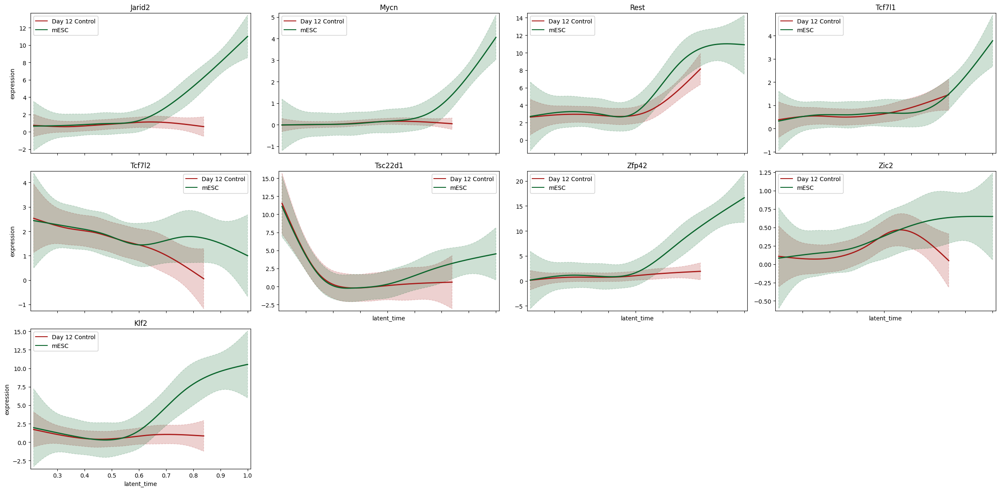

In [60]:
# Stem cell drivers in only Hic2

model = cellrank.models.GAMR(adata[hic2_indices], n_knots=6, smoothing_penalty=10.0) # Pygam can also be used with GAM instead of GAMR

cellrank.pl.gene_trends(
    adata[hic2_indices],
    model=model,
    genes=stem_cell_tfs,
    data_key="spliced",
    same_plot=True,
    ncols=4,
    time_key="latent_time",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

# Save results

In [76]:
# Save results

base_name = "cellrank_1.4"

adata.write_h5ad(
    working_directory+f"/{base_name} cells.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

dead_end_adata.write_h5ad(
    working_directory+f"/{base_name} dead end genes.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

mESC_adata.write_h5ad(
    working_directory+f"/{base_name} mESC genes.h5ad",
    compression=hdf5plugin.FILTERS["zstd"]
)

driver_df.to_csv(
    working_directory+f"{base_name} driver genes.csv",
)